# Evaluation

## Setup device and load Google Drive data

In [ ]:
!pip install scikit-posthocs
!pip install grad-cam

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 51.4 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 89.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 71.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 40.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 15.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 43.6 MB/s e

### Mount drive and set device

In [ ]:
import torch
from google.colab import drive

drive.mount('/content/drive')
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

Mounted at /content/drive
cuda


### Load BCN20000 evaluation data and calculate mean and std dev

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

rn_df = pd.read_csv('/content/drive/MyDrive/Praca magisterska/Wyniki/rn_metrics.csv')
rn_df['test_acc'] = rn_df['test_acc'] * 0.01

dn_df = pd.read_csv('/content/drive/MyDrive/Praca magisterska/Wyniki/dn_metrics.csv')
dn_df['test_acc'] = dn_df['test_acc'] * 0.01

vit_df = pd.read_csv('/content/drive/MyDrive/Praca magisterska/Wyniki/vit_metrics.csv')
vit_df['test_acc'] = vit_df['test_acc'] * 0.01

rn_aug_df = pd.read_csv('/content/drive/MyDrive/Praca magisterska/Wyniki/rn_aug_metrics.csv')
rn_aug_df['test_acc'] = rn_aug_df['test_acc'] * 0.01

dn_aug_df = pd.read_csv('/content/drive/MyDrive/Praca magisterska/Wyniki/dn_aug_metrics.csv')
dn_aug_df['test_acc'] = dn_aug_df['test_acc'] * 0.01

vit_aug_df = pd.read_csv('/content/drive/MyDrive/Praca magisterska/Wyniki/vit_aug_metrics.csv')
vit_aug_df['test_acc'] = vit_aug_df['test_acc'] * 0.01

rn_ft_df = pd.read_csv('/content/drive/MyDrive/Praca magisterska/Wyniki/rn_ft_metrics.csv')
rn_ft_df['test_acc'] = rn_ft_df['test_acc'] * 0.01

dn_ft_df = pd.read_csv('/content/drive/MyDrive/Praca magisterska/Wyniki/dn_ft_metrics.csv')
dn_ft_df['test_acc'] = dn_ft_df['test_acc'] * 0.01

vit_ft_df = pd.read_csv('/content/drive/MyDrive/Praca magisterska/Wyniki/vit_ft_metrics.csv')
vit_ft_df['test_acc'] = vit_ft_df['test_acc'] * 0.01

rn_aug_ft_df = pd.read_csv('/content/drive/MyDrive/Praca magisterska/Wyniki/rn_aug_ft_metrics.csv')
rn_aug_ft_df['test_acc'] = rn_aug_ft_df['test_acc'] * 0.01

dn_aug_ft_df = pd.read_csv('/content/drive/MyDrive/Praca magisterska/Wyniki/dn_aug_ft_metrics.csv')
dn_aug_ft_df['test_acc'] = dn_aug_ft_df['test_acc'] * 0.01

vit_aug_ft_df = pd.read_csv('/content/drive/MyDrive/Praca magisterska/Wyniki/vit_aug_ft_metrics.csv')
vit_aug_ft_df['test_acc'] = vit_aug_ft_df['test_acc'] * 0.01

def print_df(df, name):
    print(name)
    print(df.head())
    metrics = ['test_acc', 'test_precision', 'test_recall', 'test_f1']
    for metric in metrics:
        mean = df[metric].mean()
        std = df[metric].std()
        print(f"{metric}: mean = {mean:.4f}, std = {std:.4f}")

print_df(rn_df, "ResNet")
print_df(dn_df, "DenseNet")
print_df(vit_df, "Vision Transformer")

print_df(rn_aug_df, "Augmented ResNet")
print_df(dn_aug_df, "Augmented DenseNet")
print_df(vit_aug_df, "Augmented Vision Transformer")

print_df(rn_ft_df, "ResNet Transfer Learning")
print_df(dn_ft_df, "DenseNet Transfer Learning")
print_df(vit_ft_df, "Vision Transformer Transfer Learning")

print_df(rn_aug_ft_df, "ResNet Augmented + Transfer Learning")
print_df(dn_aug_ft_df, "DenseNet Augmented + Transfer Learning")
print_df(vit_aug_ft_df, "Vision Transformer Augmented + Transfer Learning")

### Friedman and Nemenyi tests

In [ ]:
from scipy.stats import friedmanchisquare
import scikit_posthocs as sp
import pandas as pd

model_data = {
    'ResNet_Baseline': rn_df,
    'DenseNet_Baseline': dn_df,
    'ViT_Baseline': vit_df,
    'ResNet_Augmented': rn_aug_df,
    'DenseNet_Augmented': dn_aug_df,
    'ViT_Augmented': vit_aug_df,
    'ResNet_Transfer': rn_ft_df,
    'DenseNet_Transfer': dn_ft_df,
    'ViT_Transfer': vit_ft_df,
    'ResNet_Augmented+Transfer': rn_aug_ft_df,
    'DenseNet_Augmented+Transfer': dn_aug_ft_df,
    'ViT_Augmented+Transfer': vit_aug_ft_df
}

architectures = ['ResNet', 'DenseNet', 'ViT']
configurations = ['Baseline', 'Augmented', 'Transfer', 'Augmented+Transfer']
metrics_to_test = ['test_acc', 'test_precision', 'test_recall', 'test_f1']
alpha = 0.05

for arch in architectures:
    print(f"{arch}")

    data_for_friedman = {}
    for config in configurations:
        data_for_friedman[config] = model_data[f"{arch}_{config}"]

    for metric in metrics_to_test:
        print(f"Metryka: {metric}")

        friedman_input = [data_for_friedman[config][metric].values for config in configurations]
        stat_friedman, p_value_friedman = friedmanchisquare(*friedman_input)
        print(f"  Friedman test: Statystyka = {stat_friedman:.4f}, p-value = {p_value_friedman:.4f}")

        if p_value_friedman < alpha:
            print("Nemenyi test :")
            combined_data = pd.DataFrame({config: data_for_friedman[config][metric].values for config in configurations})
            nemenyi_result = sp.posthoc_nemenyi_friedman(combined_data.values)

            nemenyi_result.index = configurations
            nemenyi_result.columns = configurations

            print("  Nemenyi results (p-values):")
            print(nemenyi_result)
        else:
            print("  No significant differences.")

        print()
    print()

ResNet
Metryka: test_acc
  Friedman test: Statystyka = 13.0800, p-value = 0.0045
Nemenyi test :
  Nemenyi results (p-values):
                    Baseline  Augmented  Transfer  Augmented+Transfer
Baseline            1.000000   0.883087  0.007913            0.068119
Augmented           0.883087   1.000000  0.068119            0.315940
Transfer            0.007913   0.068119  1.000000            0.883087
Augmented+Transfer  0.068119   0.315940  0.883087            1.000000

Metryka: test_precision
  Friedman test: Statystyka = 10.9200, p-value = 0.0122
Nemenyi test :
  Nemenyi results (p-values):
                    Baseline  Augmented  Transfer  Augmented+Transfer
Baseline            1.000000   0.961371  0.017325            0.203470
Augmented           0.961371   1.000000  0.068119            0.455933
Transfer            0.017325   0.068119  1.000000            0.760994
Augmented+Transfer  0.203470   0.455933  0.760994            1.000000

Metryka: test_recall
  Friedman test: Statystyk

### Boxplots

/tmp/ipython-input-6-4284105130.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='config', y=metric, data=combined_arch_df, ax=ax, palette='viridis')
/tmp/ipython-input-6-4284105130.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='config', y=metric, data=combined_arch_df, ax=ax, palette='viridis')
/tmp/ipython-input-6-4284105130.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='config', y=metric, data=combined_arch_df, ax=ax, palette='viridis')
/tmp/ipython-input-6-4284105130.py:27: FutureWarning: 

Passing `palette` witho

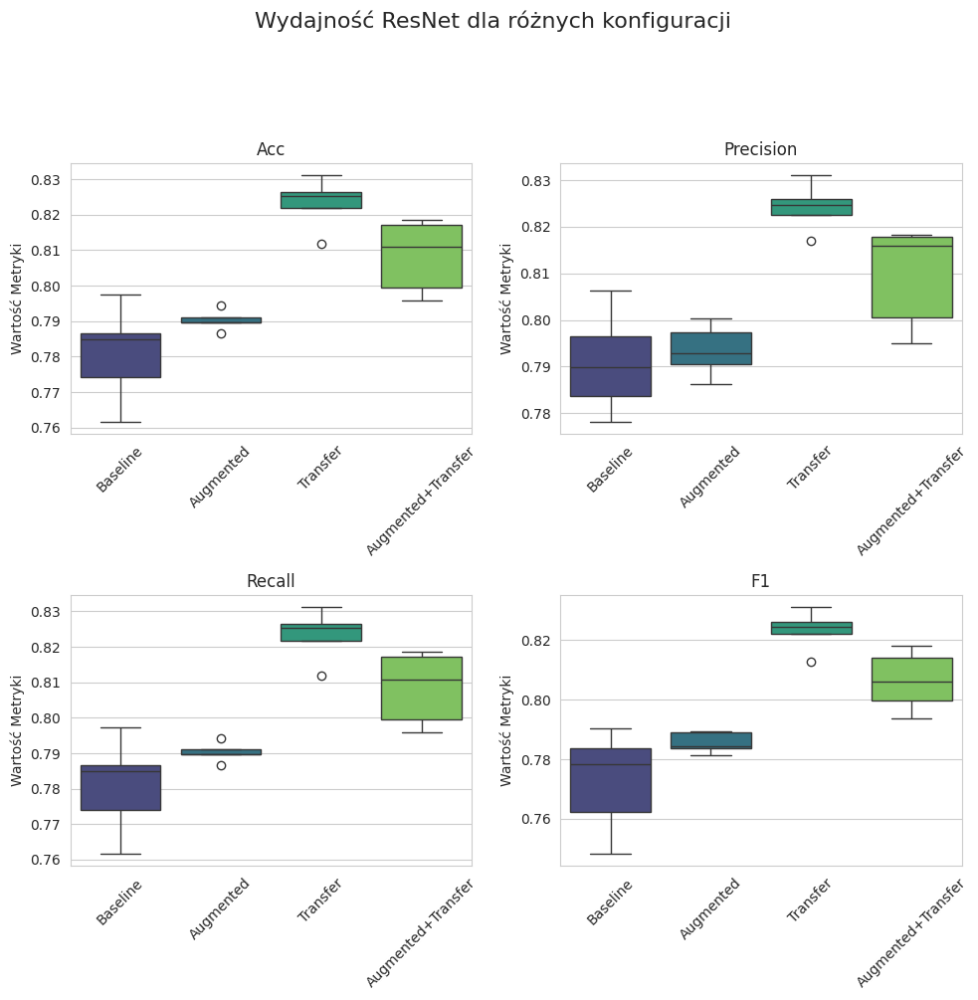

/tmp/ipython-input-6-4284105130.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='config', y=metric, data=combined_arch_df, ax=ax, palette='viridis')
/tmp/ipython-input-6-4284105130.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='config', y=metric, data=combined_arch_df, ax=ax, palette='viridis')
/tmp/ipython-input-6-4284105130.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='config', y=metric, data=combined_arch_df, ax=ax, palette='viridis')
/tmp/ipython-input-6-4284105130.py:27: FutureWarning: 

Passing `palette` witho

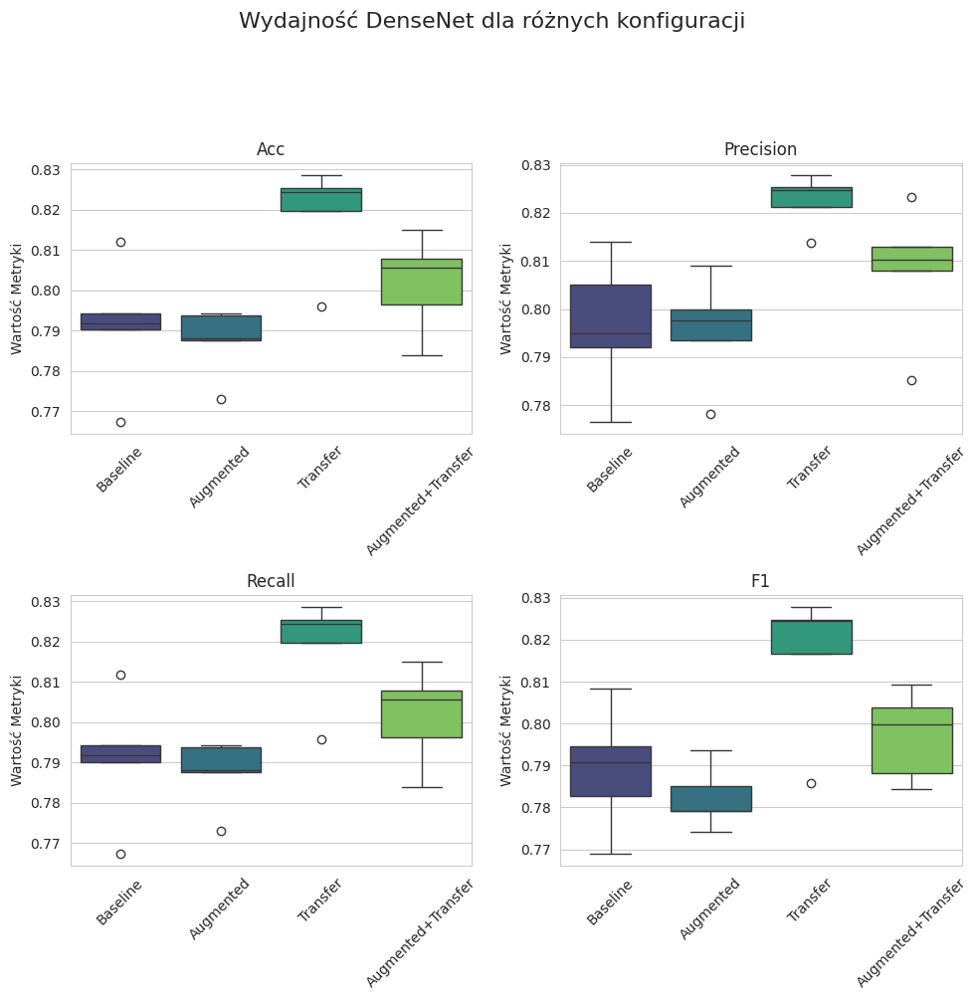

/tmp/ipython-input-6-4284105130.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='config', y=metric, data=combined_arch_df, ax=ax, palette='viridis')
/tmp/ipython-input-6-4284105130.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='config', y=metric, data=combined_arch_df, ax=ax, palette='viridis')
/tmp/ipython-input-6-4284105130.py:27: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='config', y=metric, data=combined_arch_df, ax=ax, palette='viridis')
/tmp/ipython-input-6-4284105130.py:27: FutureWarning: 

Passing `palette` witho

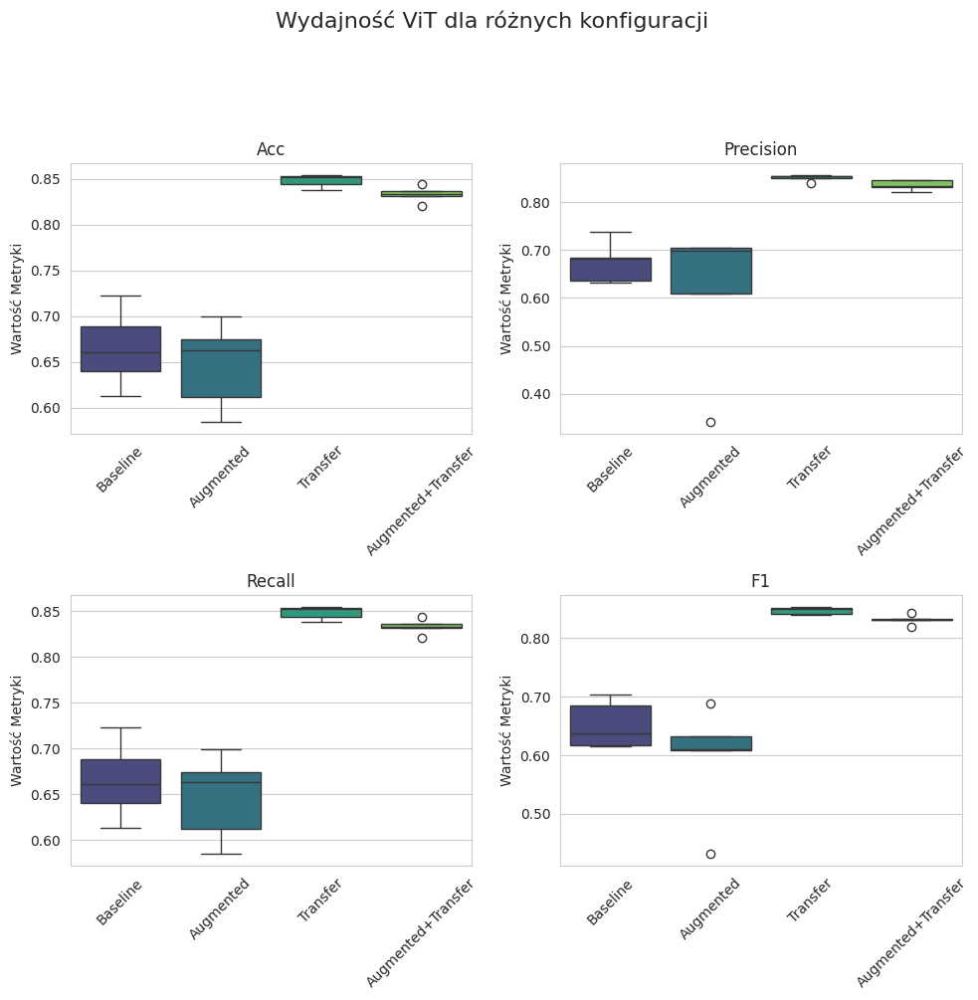

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.set_style("whitegrid")
plt.rcParams['figure.dpi'] = 100

metrics_to_plot = ['test_acc', 'test_precision', 'test_recall', 'test_f1']

for arch in architectures:

    combined_data_list = []
    for config_name in configurations:
        df_temp = model_data[f"{arch}_{config_name}"].copy()
        df_temp['config'] = config_name
        combined_data_list.append(df_temp)

    combined_arch_df = pd.concat(combined_data_list, ignore_index=True)

    fig, axes = plt.subplots(2, 2, figsize=(10, 10), sharey=False)
    fig.suptitle(f'Wydajność {arch} dla różnych konfiguracji', fontsize=16, y=1.03)

    axes = axes.flatten()

    for i, metric in enumerate(metrics_to_plot):
        ax = axes[i]

        sns.boxplot(x='config', y=metric, data=combined_arch_df, ax=ax, palette='viridis')

        ax.set_title(f'{metric.replace("test_", "").replace("_", " ").title()}', fontsize=12)
        ax.set_xlabel('')
        ax.set_ylabel('Wartość Metryki')

        ax.yaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f'{x:.2f}'))
        ax.tick_params(axis='x', rotation=45)

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()


## Load data (HAM10000)

Podział klas:
benign_malignant
benign       8061
malignant    1954
Name: count, dtype: int64


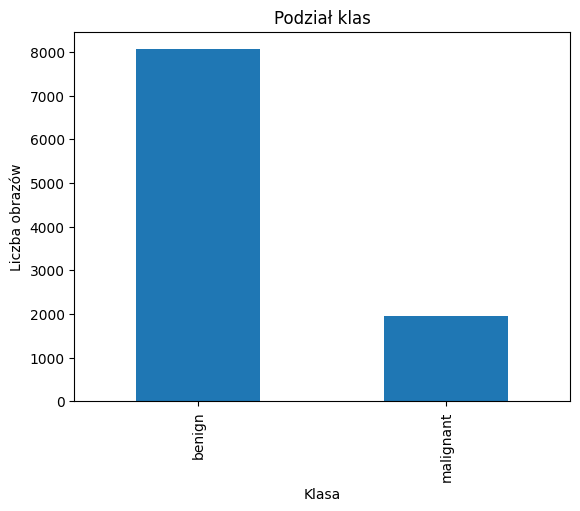

Podział klas:
dx
nv       6705
mel      1113
bkl      1099
bcc       514
akiec     327
vasc      142
df        115
Name: count, dtype: int64


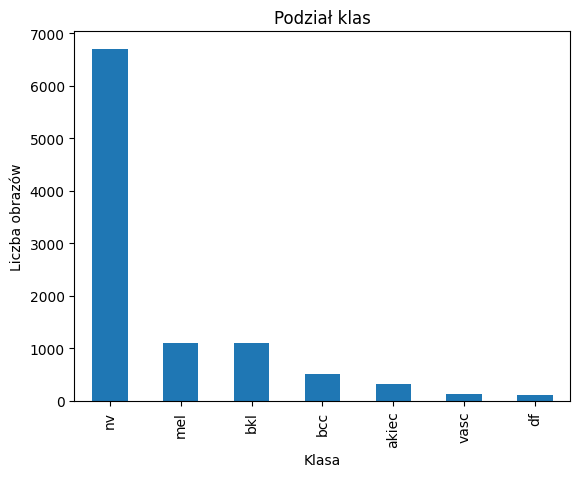

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt


df_ham10k = pd.read_csv('/content/drive/MyDrive/Praca magisterska/Dane/HAM10000/metadata.csv')
df_ham10k = df_ham10k.dropna(subset=['dx'])
dx_map = {
    'akiec': 'malignant',
    'bcc': 'malignant',
    'mel': 'malignant',
    'bkl': 'benign',
    'df': 'benign',
    'nv': 'benign',
    'vasc': 'benign'
}

df_ham10k['benign_malignant'] = df_ham10k['dx'].map(dx_map)

print("Podział klas:")
print(df_ham10k['benign_malignant'].value_counts())

df_ham10k['benign_malignant'].value_counts().plot(kind='bar', title='Podział klas')
plt.xlabel('Klasa')
plt.ylabel('Liczba obrazów')
plt.show()


print("Podział klas:")
print(df_ham10k['dx'].value_counts())

df_ham10k['dx'].value_counts().plot(kind='bar', title='Podział klas')
plt.xlabel('Klasa')
plt.ylabel('Liczba obrazów')
plt.show()

### Download images

In [ ]:
!gdown 'path' -O 'HAM10000.zip'
!unzip /content/HAM10000.zip -d /content/HAM10000/

Streaming output truncated to the last 5000 lines.
 extracting: /content/HAM10000/ISIC_0029321.jpg  
 extracting: /content/HAM10000/ISIC_0029322.jpg  
  inflating: /content/HAM10000/ISIC_0029323.jpg  
 extracting: /content/HAM10000/ISIC_0029324.jpg  
 extracting: /content/HAM10000/ISIC_0029325.jpg  
 extracting: /content/HAM10000/ISIC_0029326.jpg  
 extracting: /content/HAM10000/ISIC_0029327.jpg  
 extracting: /content/HAM10000/ISIC_0029328.jpg  
 extracting: /content/HAM10000/ISIC_0029329.jpg  
 extracting: /content/HAM10000/ISIC_0029330.jpg  
  inflating: /content/HAM10000/ISIC_0029331.jpg  
  inflating: /content/HAM10000/ISIC_0029332.jpg  
 extracting: /content/HAM10000/ISIC_0029333.jpg  
 extracting: /content/HAM10000/ISIC_0029334.jpg  
  inflating: /content/HAM10000/ISIC_0029335.jpg  
 extracting: /content/HAM10000/ISIC_0029336.jpg  
  inflating: /content/HAM10000/ISIC_0029337.jpg  
 extracting: /content/HAM10000/ISIC_0029338.jpg  
  inflating: /content/HAM10000/ISIC_0029339.jpg  

## HAM10000 dataset loader

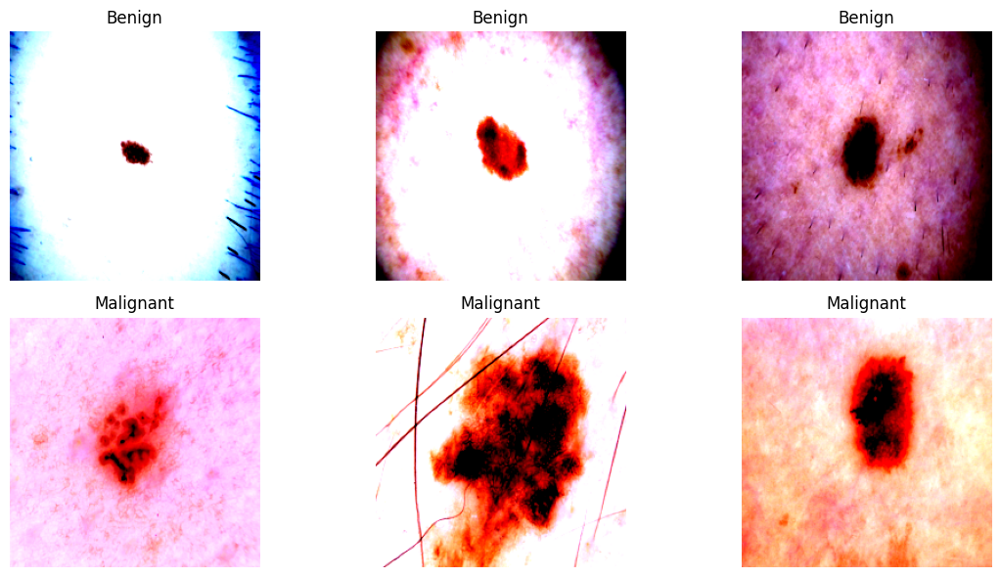

In [ ]:
from torch.utils.data import DataLoader, Subset, Dataset
from PIL import Image
from torchvision import models, transforms, datasets
import random
import os

class HAM10000Dataset(Dataset):
    def __init__(self, dataframe, img_dir, transform=None):
        self.df = dataframe
        self.img_dir = img_dir
        self.transform = transform
        self.label_map = {'benign': 0, 'malignant': 1}

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        image_path = os.path.join(self.img_dir, row['image_id'] + '.jpg')
        image = Image.open(image_path).convert('RGB')
        label = self.label_map[row['benign_malignant']]
        original_class = row['dx']
        if self.transform:
            image = self.transform(image)

        return image, label, original_class


BATCH_SIZE = 32
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])

IMG_DIR = '/content/HAM10000'
dataset = HAM10000Dataset(df_ham10k, IMG_DIR, transform)
data_loader = DataLoader(dataset, BATCH_SIZE, shuffle=True)

benign_idx = [i for i, row in dataset.df.iterrows() if row['benign_malignant'] == 'benign']
malignant_idx = [i for i, row in dataset.df.iterrows() if row['benign_malignant'] == 'malignant']

samples = random.sample(benign_idx, 3) + random.sample(malignant_idx, 3)
fig, axs = plt.subplots(2, 3, figsize=(12, 6))
for ax, idx in zip(axs.flatten(), samples):
    image, label, x = dataset[idx]
    ax.imshow(image.permute(1, 2, 0))
    ax.axis('off')
    ax.set_title('Benign' if label == 0 else 'Malignant')

plt.tight_layout()
plt.show()

## Load models

In [ ]:
def load_model(path):
    model = torch.load(path, map_location=device, weights_only=False)
    model.to(device)
    model.eval()
    return model

rn = load_model('/content/drive/MyDrive/Praca magisterska/Modele/rn.pt')
rn_aug = load_model('/content/drive/MyDrive/Praca magisterska/Modele/rn_aug.pt')
rn_ft = load_model('/content/drive/MyDrive/Praca magisterska/Modele/rn_ft.pt')
rn_aug_ft = load_model('/content/drive/MyDrive/Praca magisterska/Modele/rn_aug_ft.pt')

dn = load_model('/content/drive/MyDrive/Praca magisterska/Modele/dn.pt')
dn_aug = load_model('/content/drive/MyDrive/Praca magisterska/Modele/dn_aug.pt')
dn_ft = load_model('/content/drive/MyDrive/Praca magisterska/Modele/dn_ft.pt')
dn_aug_ft = load_model('/content/drive/MyDrive/Praca magisterska/Modele/dn_aug_ft.pt')

vit = load_model('/content/drive/MyDrive/Praca magisterska/Modele/vit.pt')
vit_aug = load_model('/content/drive/MyDrive/Praca magisterska/Modele/vit_aug.pt')
vit_ft = load_model('/content/drive/MyDrive/Praca magisterska/Modele/vit_ft.pt')
vit_aug_ft = load_model('/content/drive/MyDrive/Praca magisterska/Modele/vit_aug_ft.pt')

## Evaluate

In [ ]:
import numpy as np
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score
from tqdm import tqdm
from collections import defaultdict

def evaluate_model(model, dataloader):
    all_preds = []
    all_labels = []
    all_probs = []
    all_dx = []

    with torch.no_grad():
        for images, labels, dx in tqdm(dataloader, f"Ewaluacja modelu"):
            images = images.to(device)
            labels = labels.to(device)
            outputs = model(images)
            probs = torch.softmax(outputs, dim=1)[:,1]
            preds = torch.argmax(outputs, dim=1)

            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(labels.cpu().numpy())
            all_probs.extend(probs.cpu().numpy())
            all_dx.extend(dx)

    y_true = np.array(all_labels)
    y_pred = np.array(all_preds)
    y_prob = np.array(all_probs)
    dx_list = np.array(all_dx)

    metrics = {
        'Labels': all_labels,
        'Probabilities': all_probs,
        'Predictions': all_preds,
        'Dokladnosc': accuracy_score(y_true, y_pred),
        'Precyzja': precision_score(y_true, y_pred),
        'Czulosc': recall_score(y_true, y_pred),
        'F1 Score': f1_score(y_true, y_pred),
        'ROC AUC': roc_auc_score(y_true, y_prob)
    }

    class_errors = defaultdict(lambda: {'total': 0, 'errors': 0})

    for true, pred, dx in zip(y_true, y_pred, dx_list):
        class_errors[dx]['total'] += 1
        if true != pred:
            class_errors[dx]['errors'] += 1

    class_error_rates = {cls: errs['errors'] / errs['total']
                         for cls, errs in class_errors.items()}

    error_by_classes = {
        'OriginalClasses': dx_list,
        'ErrorByClass': class_error_rates
    }

    return metrics, error_by_classes

### ResNet

In [ ]:
rn_results, rn_error_by_class = evaluate_model(rn, data_loader)
rn_augmented_results, rn_augmented_error_by_class = evaluate_model(rn_aug, data_loader)
rn_ft_results, rn_ft_error_by_class = evaluate_model(rn_ft, data_loader)
rn_aug_ft_results, rn_aug_ft_error_by_class = evaluate_model(rn_aug_ft, data_loader)

Ewaluacja modelu: 100%|██████████| 313/313 [01:58<00:00,  2.65it/s]


### DenseNet

In [ ]:
densenet_results, densenet_error_by_class = evaluate_model(dn, data_loader)
densenet_augmented_results, densenet_augmented_error_by_class = evaluate_model(dn_aug, data_loader)
densenet_ft_results, densenet_ft_error_by_class = evaluate_model(dn_ft, data_loader)
densenet_aug_ft_results, densenet_aug_ft_error_by_class = evaluate_model(dn_aug_ft, data_loader)

Ewaluacja modelu: 100%|██████████| 313/313 [02:00<00:00,  2.60it/s]


### Vision Tranformer

In [ ]:
vit_results, vit_error_by_class = evaluate_model(vit, data_loader)
vit_augmented_results, vit_augmented_error_by_class = evaluate_model(vit_aug, data_loader)
vit_ft_results, vit_ft_error_by_class = evaluate_model(vit_ft, data_loader)
vit_aug_ft_results, vit_aug_ft_error_by_class = evaluate_model(vit_aug_ft, data_loader)

Ewaluacja modelu: 100%|██████████| 313/313 [03:08<00:00,  1.66it/s]


## Print results

In [ ]:
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, roc_auc_score, roc_curve
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

def print_metrics(results, error_by_classes, model_name="Model"):
    acc = results['Dokladnosc']
    prec = results['Precyzja']
    rec = results['Czulosc']
    f1 = results['F1 Score']
    auc = results['ROC AUC']
    labels = results['Labels']
    preds = results['Predictions']
    probs = results['Probabilities']

    # Metryki
    print(f"Rezultaty dla {model_name}")
    print(f"Dokładność   : {acc:.4f}")
    print(f"Precyzja     : {prec:.4f}")
    print(f"Czułość      : {rec:.4f}")
    print(f"F1 Score     : {f1:.4f}")
    print(f"ROC AUC      : {auc:.4f}")

    fig, axes = plt.subplots(1, 2, figsize=(12, 5))

    # Macierz konfuzji
    cm = confusion_matrix(labels, preds)
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=axes[0])
    axes[0].set_title(f'Macierz konfuzji: {model_name}')
    axes[0].set_xlabel('Predicted')
    axes[0].set_ylabel('True')

    # Krzywa ROC
    fpr, tpr, _ = roc_curve(labels, probs)
    axes[1].plot(fpr, tpr, label=f'{model_name} (AUC = {auc:.2f})')
    axes[1].plot([0, 1], [0, 1], linestyle='--', color='gray')
    axes[1].set_xlabel('False Positive Rate')
    axes[1].set_ylabel('True Positive Rate')
    axes[1].set_title(f'Krzywa ROC: {model_name}')
    axes[1].legend()
    axes[1].grid(True, linestyle='--', alpha=0.6)

    plt.tight_layout()
    plt.show()

### ResNet

Rezultaty dla ResNet
Dokładność   : 0.7917
Precyzja     : 0.4647
Czułość      : 0.4447
F1 Score     : 0.4545
ROC AUC      : 0.7458


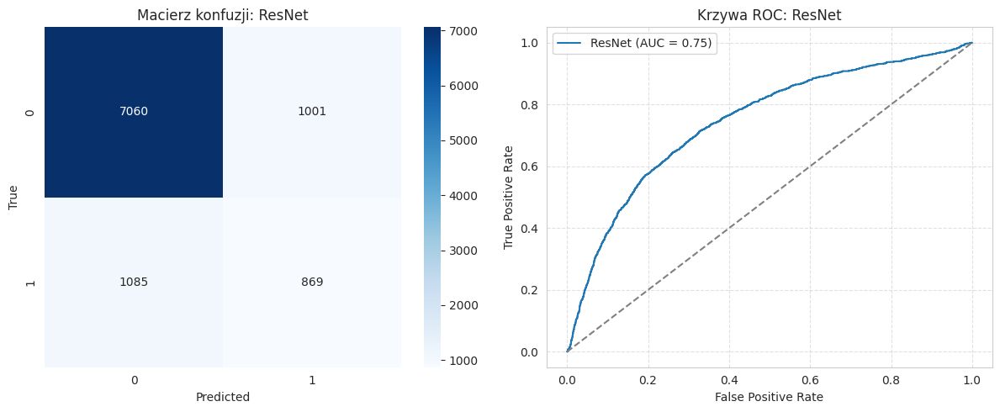

Rezultaty dla Augmented ResNet
Dokładność   : 0.8103
Precyzja     : 0.5183
Czułość      : 0.3915
F1 Score     : 0.4461
ROC AUC      : 0.7243


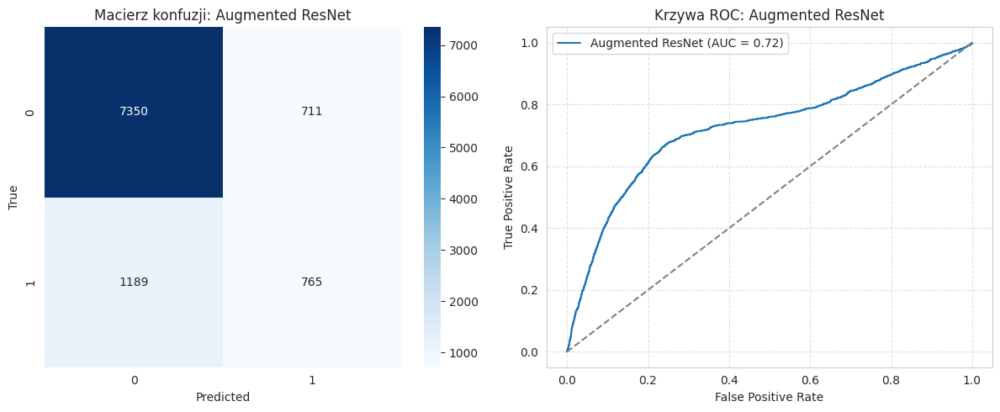

Rezultaty dla Transfer Learning ResNet
Dokładność   : 0.7598
Precyzja     : 0.4149
Czułość      : 0.5640
F1 Score     : 0.4781
ROC AUC      : 0.7577


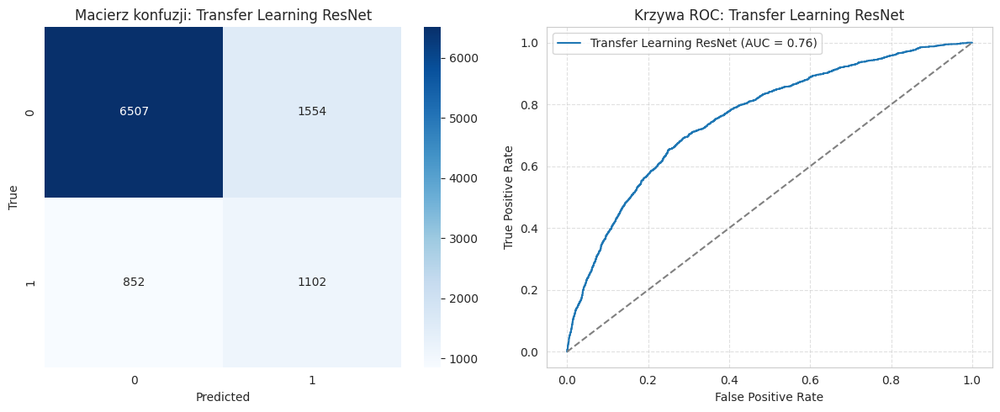

Rezultaty dla Augmented + Transfer Learning ResNet
Dokładność   : 0.8107
Precyzja     : 0.5167
Czułość      : 0.4591
F1 Score     : 0.4862
ROC AUC      : 0.7935


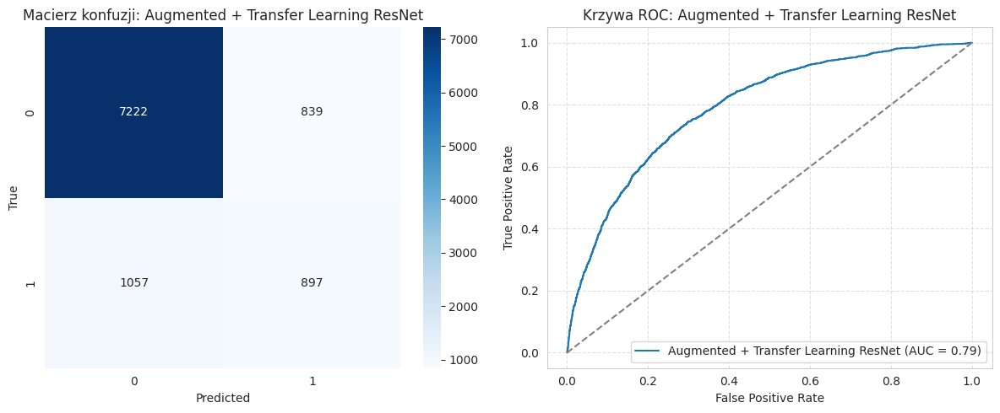

In [ ]:
print_metrics(rn_results, rn_error_by_class, model_name="ResNet")
print_metrics(rn_augmented_results, rn_error_by_class, model_name="Augmented ResNet")
print_metrics(rn_ft_results, rn_ft_error_by_class, model_name="Transfer Learning ResNet")
print_metrics(rn_aug_ft_results, rn_aug_ft_error_by_class, model_name="Augmented + Transfer Learning ResNet")

### DenseNet

Rezultaty dla DenseNet
Dokładność   : 0.7734
Precyzja     : 0.4392
Czułość      : 0.5819
F1 Score     : 0.5006
ROC AUC      : 0.7922


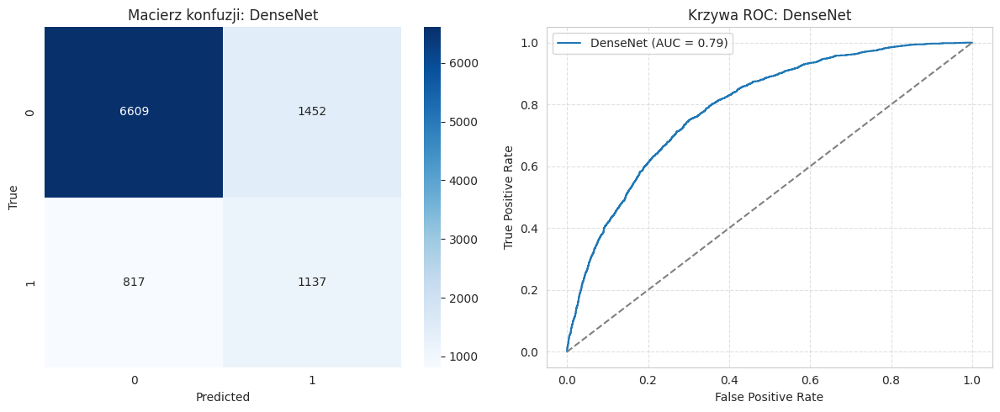

Rezultaty dla Augmented DenseNet
Dokładność   : 0.7936
Precyzja     : 0.4616
Czułość      : 0.3475
F1 Score     : 0.3965
ROC AUC      : 0.7050


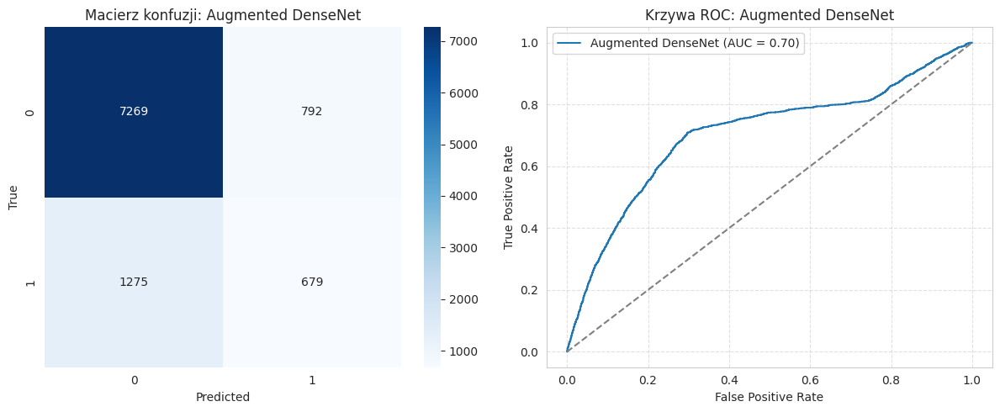

Rezultaty dla Transfer Learning DenseNet
Dokładność   : 0.8085
Precyzja     : 0.5132
Czułość      : 0.3588
F1 Score     : 0.4223
ROC AUC      : 0.7959


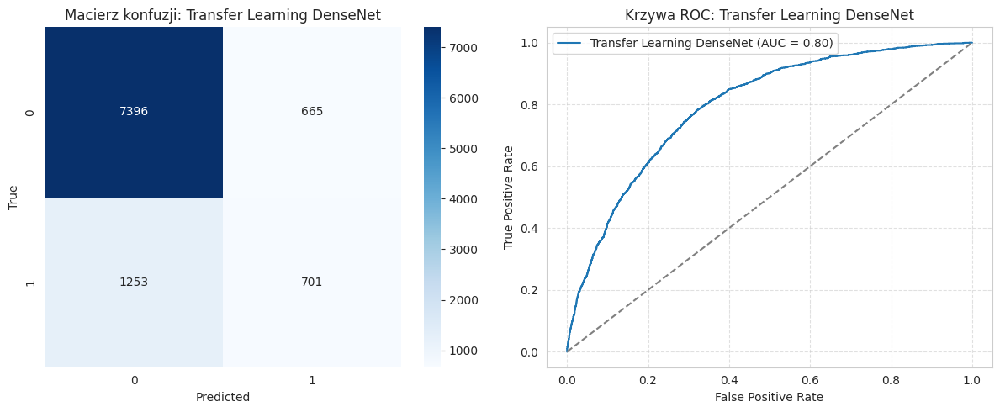

Rezultaty dla Augmented + Transfer Learning DenseNet
Dokładność   : 0.8159
Precyzja     : 0.5349
Czułość      : 0.4319
F1 Score     : 0.4779
ROC AUC      : 0.8000


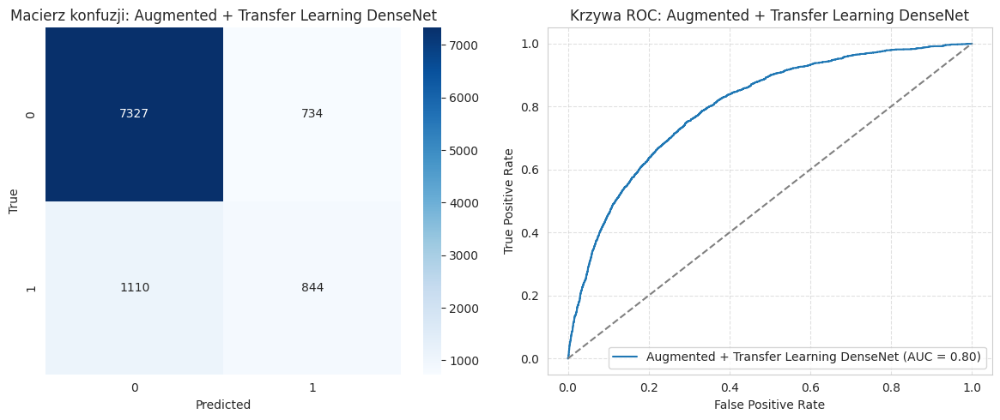

In [ ]:
print_metrics(densenet_results, densenet_error_by_class, model_name="DenseNet")
print_metrics(densenet_augmented_results, densenet_augmented_error_by_class, model_name="Augmented DenseNet")
print_metrics(densenet_ft_results, densenet_ft_error_by_class, model_name="Transfer Learning DenseNet")
print_metrics(densenet_aug_ft_results, densenet_aug_ft_error_by_class, model_name="Augmented + Transfer Learning DenseNet")

### Vision Transformer

Rezultaty dla Vision Transformer
Dokładność   : 0.7549
Precyzja     : 0.3336
Czułość      : 0.2569
F1 Score     : 0.2903
ROC AUC      : 0.5601


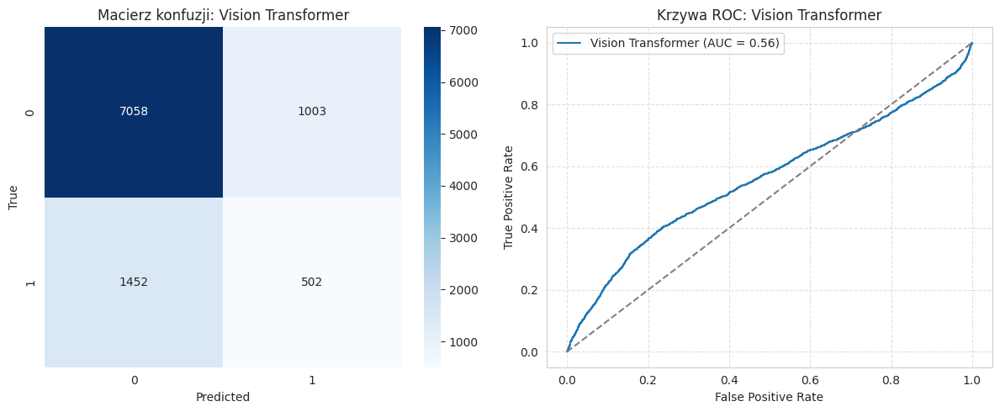

Rezultaty dla Augmented Vision Transformer
Dokładność   : 0.7304
Precyzja     : 0.2960
Czułość      : 0.2769
F1 Score     : 0.2861
ROC AUC      : 0.5762


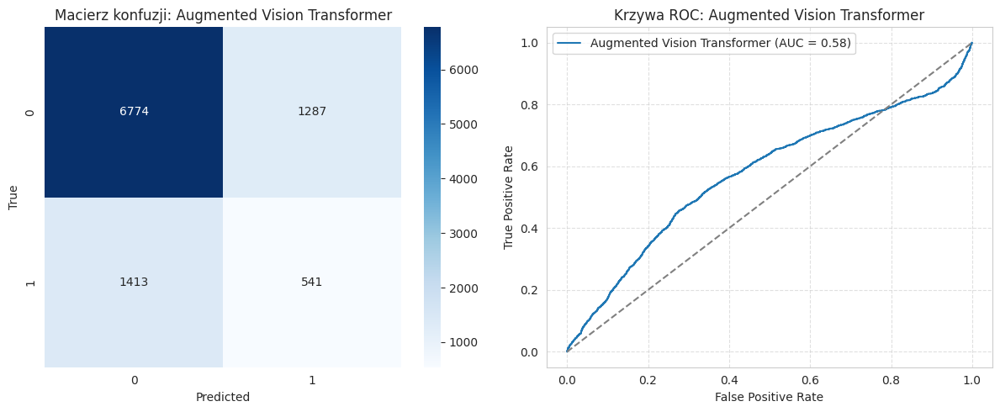

Rezultaty dla Transfer Learning Vision Transformer
Dokładność   : 0.8073
Precyzja     : 0.5080
Czułość      : 0.3905
F1 Score     : 0.4416
ROC AUC      : 0.7868


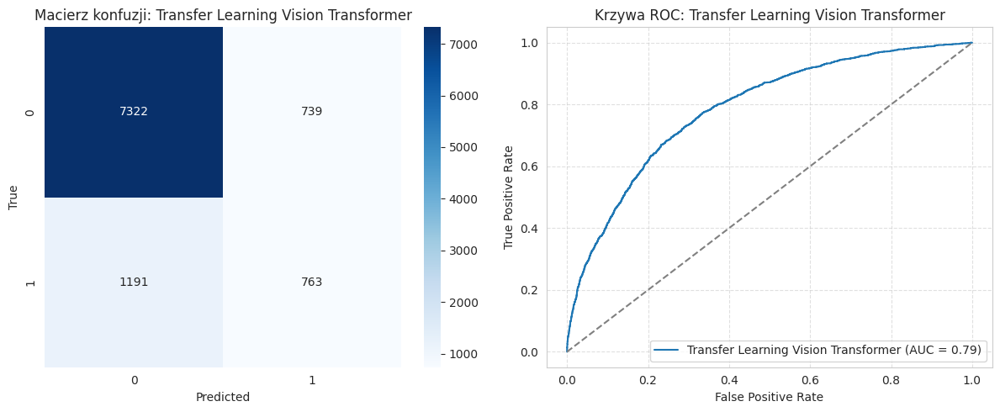

Rezultaty dla Augmented + Transfer Learning Vision Transformer
Dokładność   : 0.8130
Precyzja     : 0.5242
Czułość      : 0.4488
F1 Score     : 0.4836
ROC AUC      : 0.8082


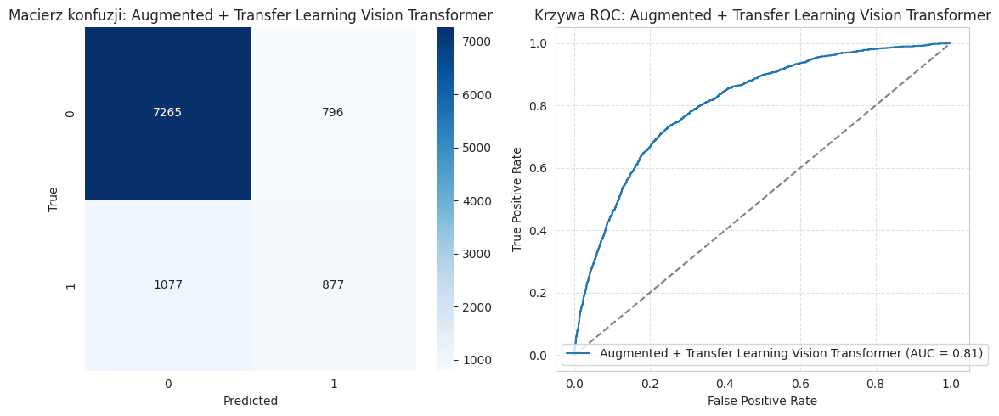

In [ ]:
print_metrics(vit_results, vit_error_by_class, model_name="Vision Transformer")
print_metrics(vit_augmented_results, vit_augmented_error_by_class, model_name="Augmented Vision Transformer")
print_metrics(vit_ft_results, vit_ft_error_by_class, model_name="Transfer Learning Vision Transformer")
print_metrics(vit_aug_ft_results, vit_aug_ft_error_by_class, model_name="Augmented + Transfer Learning Vision Transformer")

## Compare models

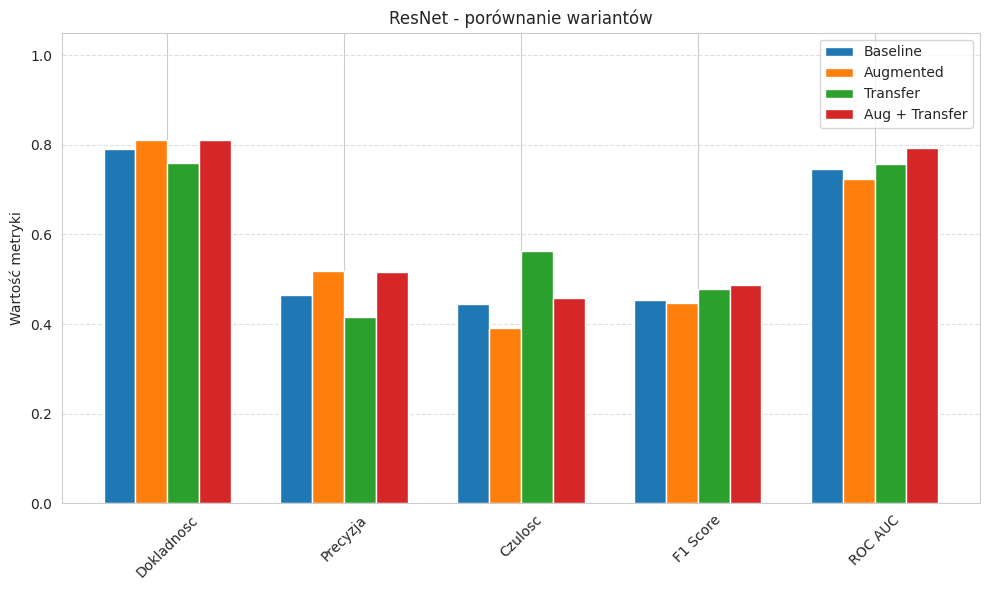

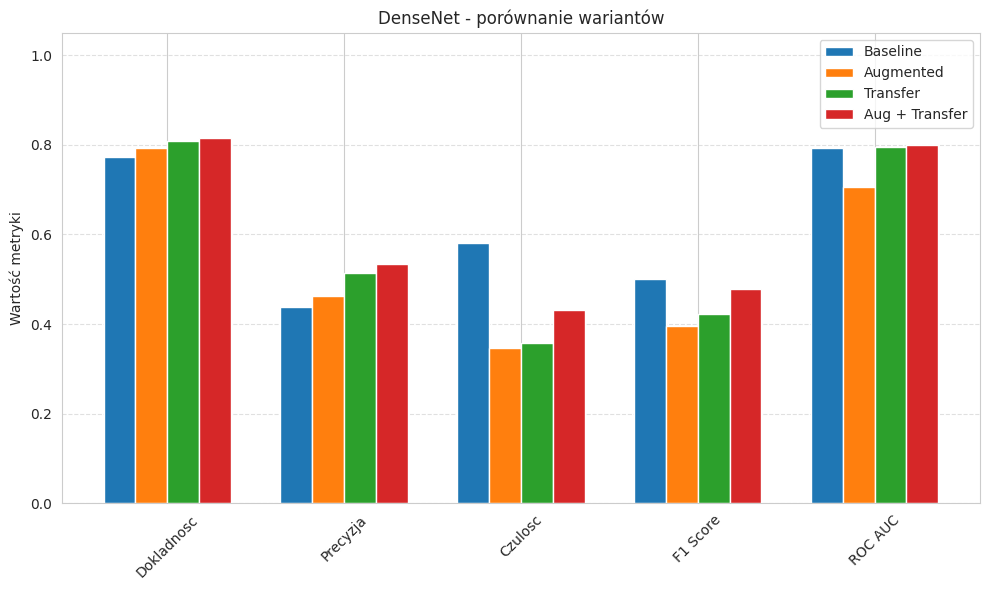

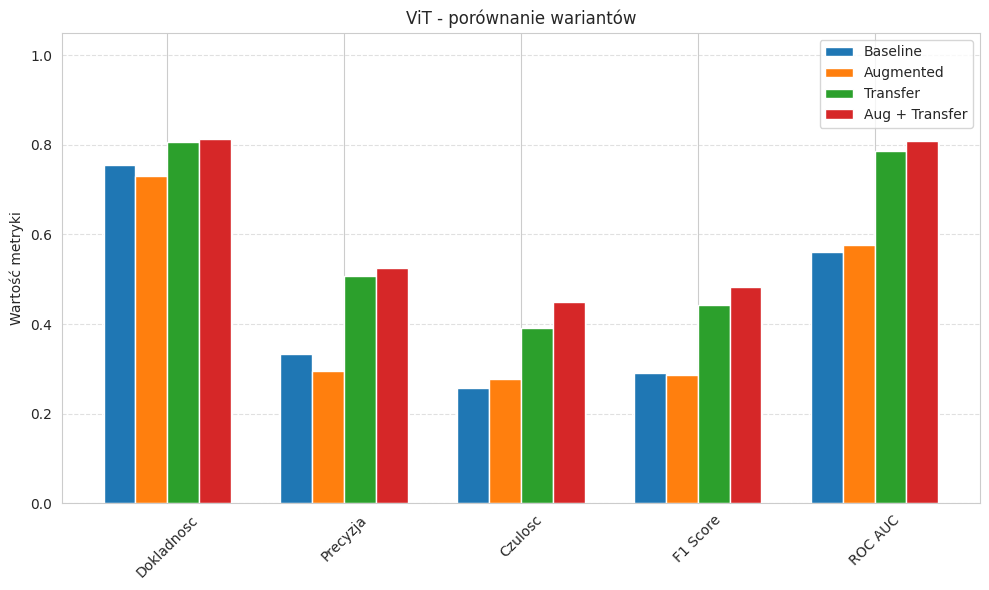

In [ ]:
import matplotlib.pyplot as plt
import numpy as np

def plot_comparison(arch_name, variant_names, variant_results):
    metric_names = ['Dokladnosc', 'Precyzja', 'Czulosc', 'F1 Score', 'ROC AUC']
    x = np.arange(len(metric_names))
    width = 0.18

    plt.figure(figsize=(10, 6))

    for i, (variant, result) in enumerate(zip(variant_names, variant_results)):
        values = [result[metric] for metric in metric_names]
        plt.bar(x + i*width, values, width, label=variant)

    plt.xticks(x + width * (len(variant_names) - 1) / 2, metric_names, rotation=45)
    plt.ylim(0, 1.05)
    plt.title(f'{arch_name} - porównanie wariantów')
    plt.ylabel('Wartość metryki')
    plt.grid(axis='y', linestyle='--', alpha=0.6)
    plt.legend()
    plt.tight_layout()
    plt.show()

variant_names = ['Baseline', 'Augmented', 'Transfer', 'Aug + Transfer']

plot_comparison('ResNet', variant_names, [
    rn_results, rn_augmented_results, rn_ft_results, rn_aug_ft_results
])

plot_comparison('DenseNet', variant_names, [
    densenet_results, densenet_augmented_results, densenet_ft_results, densenet_aug_ft_results
])

plot_comparison('ViT', variant_names, [
    vit_results, vit_augmented_results, vit_ft_results, vit_aug_ft_results
])

## XAI

### Load BCN20000

In [ ]:
!unzip /content/images.zip -d /content/images/


Streaming output truncated to the last 5000 lines.
  inflating: /content/images/ISIC_0068029.jpg  
  inflating: /content/images/ISIC_0068030.jpg  
  inflating: /content/images/ISIC_0068031.jpg  
  inflating: /content/images/ISIC_0068032.jpg  
  inflating: /content/images/ISIC_0068033.jpg  
  inflating: /content/images/ISIC_0068034.jpg  
  inflating: /content/images/ISIC_0068035.jpg  
  inflating: /content/images/ISIC_0068036.jpg  
  inflating: /content/images/ISIC_0068037.jpg  
  inflating: /content/images/ISIC_0068038.jpg  
  inflating: /content/images/ISIC_0068039.jpg  
  inflating: /content/images/ISIC_0068040.jpg  
  inflating: /content/images/ISIC_0068041.jpg  
  inflating: /content/images/ISIC_0068042.jpg  
  inflating: /content/images/ISIC_0068043.jpg  
  inflating: /content/images/ISIC_0068044.jpg  
  inflating: /content/images/ISIC_0068045.jpg  
  inflating: /content/images/ISIC_0068046.jpg  
  inflating: /content/images/ISIC_0068047.jpg  
  inflating: /content/images/ISIC_006

In [ ]:
df_bcn20000 = pd.read_csv('/content/drive/MyDrive/Praca magisterska/Dane/BCN20000/bcn20000_metadata_2025-05-15.csv')

df_bcn20000 = df_bcn20000.dropna(subset=['benign_malignant'])
df_bcn20000 = df_bcn20000.reset_index(drop=True)

class BCNDataset(Dataset):
    def __init__(self, dataframe, img_dir, transform=None):
        self.df = dataframe
        self.img_dir = img_dir
        self.transform = transform
        self.label_map = {'benign': 0, 'malignant': 1}

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        image_id = row['isic_id']
        label = self.label_map[row['benign_malignant']]
        image_path = os.path.join(self.img_dir, f"{image_id}.jpg")
        image = Image.open(image_path).convert("RGB")
        if self.transform:
            image = self.transform(image)
        return image, label

BCN_20000_IM_DIR = '/content/images'

bcn_dataset = BCNDataset(df_bcn20000, BCN_20000_IM_DIR, transform)
bcn_data_loader = DataLoader(bcn_dataset, BATCH_SIZE, shuffle=True)

### Unfreeze feature extraction layers for models with transfer learning

In [ ]:
for param in rn_ft.layer4[-1].conv3.parameters():
    param.requires_grad = True

for param in rn_aug_ft.layer4[-1].conv3.parameters():
    param.requires_grad = True

for param in dn_ft.features[-1].parameters():
    param.requires_grad = True

for param in dn_aug_ft.features[-1].parameters():
    param.requires_grad = True

for param in vit_ft.encoder.layers[-1].ln_1.parameters():
    param.requires_grad = True

for param in vit_aug_ft.encoder.layers[-1].ln_1.parameters():
    param.requires_grad = True

### Helper function to generate Grad-CAM heatmap for each training configuration

In [ ]:
import torch.nn.functional as F
import numpy as np
import cv2
from pytorch_grad_cam import GradCAM
from torchvision.models.vision_transformer import VisionTransformer

def vit_reshape_transform(tensor):
    tensor = tensor[:, 1:, :]
    h = w = int(tensor.shape[1] ** 0.5)
    return tensor.permute(0, 2, 1).reshape(tensor.size(0), -1, h, w)

def generate_gradcam(model, input_tensor, target_layer, device='cuda'):
    model.eval().to(device)
    input_tensor = input_tensor.to(device)

    reshape_transform = vit_reshape_transform if isinstance(model, VisionTransformer) else None

    cam = GradCAM(model=model, target_layers=[target_layer], reshape_transform=reshape_transform)
    grayscale_cam = cam(input_tensor=input_tensor)[0, :]


    with torch.no_grad():
        output = model(input_tensor)
        class_idx = output.argmax(dim=1).item()

    return grayscale_cam, class_idx

def visualize_gradcam_variants(models, image, label, target_layers, model_names=None, device='cuda'):
    input_tensor = image.unsqueeze(0)

    cams = []
    preds = []

    for model, layer in zip(models, target_layers):
        cam, pred = generate_gradcam(model, input_tensor.clone(), layer, device)
        cams.append(cam)
        preds.append(pred)

    img = image.permute(1, 2, 0).cpu().numpy()
    img = (img - img.min()) / (img.max() - img.min() + 1e-8)

    plt.figure(figsize=(15, 4))

    plt.subplot(1, len(models)+1, 1)
    plt.imshow(img)
    plt.title(f"Oryginał\n(label={label})")
    plt.axis('off')

    for i, cam in enumerate(cams):
        heatmap = cv2.applyColorMap(np.uint8(255 * cam), cv2.COLORMAP_JET)
        heatmap = np.float32(heatmap) / 255
        superimposed_img = heatmap + img
        superimposed_img /= superimposed_img.max()

        title = model_names[i] if model_names else f"Model {i}"
        plt.subplot(1, len(models)+1, i+2)
        plt.imshow(superimposed_img)
        plt.title(f"{title}\n(pred={preds[i]})")
        plt.axis('off')

    plt.tight_layout()
    plt.show()


### Prepare layers

In [ ]:
model_names = ['Baseline', 'Augmented', 'Transfer Learning', 'Aug + Transfer Learning']

rn_models = [rn, rn_aug, rn_ft, rn_aug_ft]
rn_target_layers = [model.layer4[-1] for model in [rn, rn_aug, rn_ft, rn_aug_ft]]

dn_models = [dn, dn_aug, dn_ft, dn_aug_ft]
dn_target_layers = [model.features[-1] for model in [dn, dn_aug, dn_ft, dn_aug_ft]]

vit_models = [vit, vit_aug, vit_ft, vit_aug_ft]
vit_target_layers = [model.encoder.layers[-1].ln_1 for model in [vit, vit_aug, vit_ft ,vit_aug_ft]]

### BCN20000

#### Benign

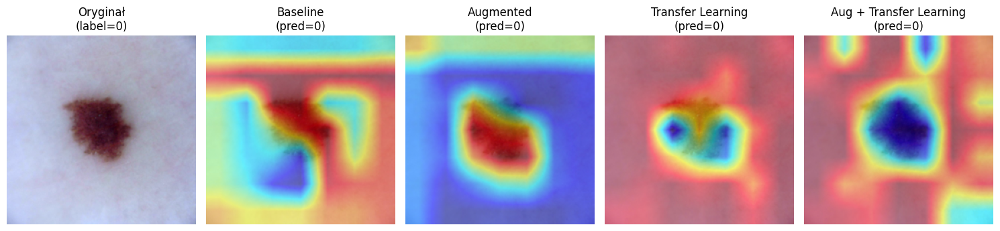

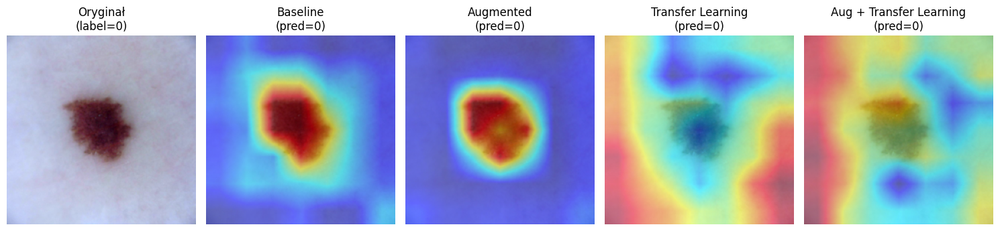

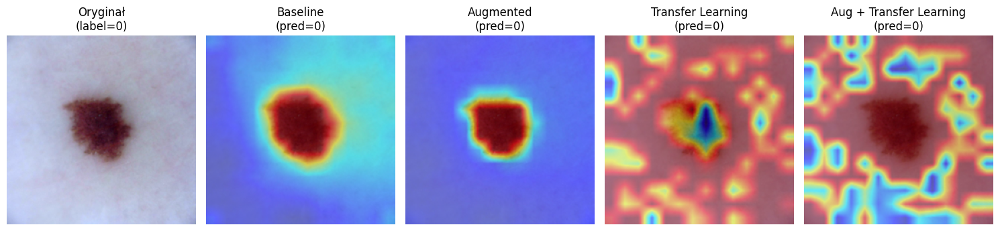

In [ ]:
isic_id = 'ISIC_0053618'
index = df_bcn20000[df_bcn20000['isic_id'] == isic_id].index[0]
image, label = bcn_dataset[index]

visualize_gradcam_variants(
    rn_models,
    image,
    label,
    target_layers=rn_target_layers,
    model_names=model_names,
    device=device
)
visualize_gradcam_variants(
    dn_models,
    image,
    label,
    target_layers=dn_target_layers,
    model_names=model_names,
    device=device
)
visualize_gradcam_variants(
    vit_models,
    image,
    label,
    target_layers=vit_target_layers,
    model_names=model_names,
    device=device
)

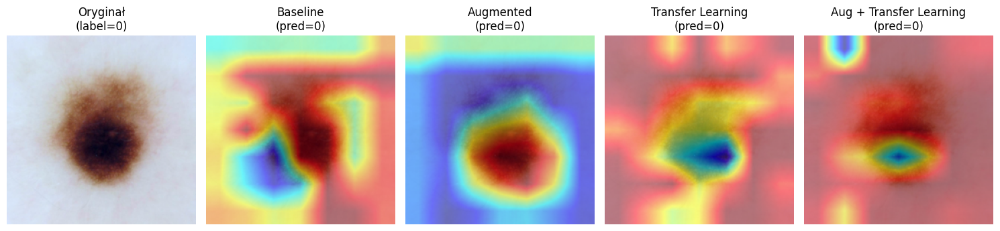

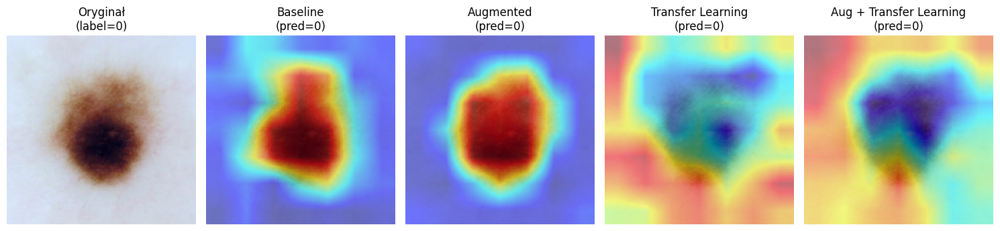

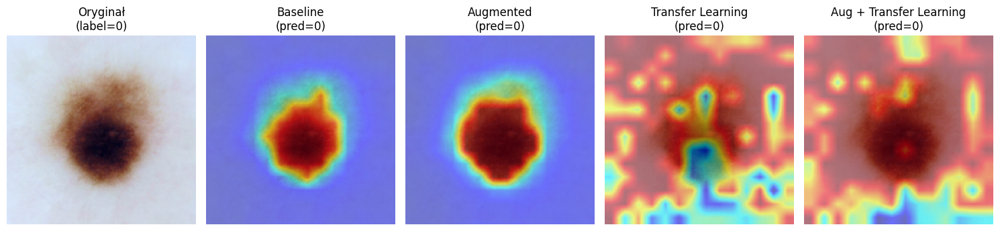

In [ ]:
isic_id = 'ISIC_0056679'
index = df_bcn20000[df_bcn20000['isic_id'] == isic_id].index[0]
image, label = bcn_dataset[index]

visualize_gradcam_variants(
    rn_models,
    image,
    label,
    target_layers=rn_target_layers,
    model_names=model_names,
    device=device
)
visualize_gradcam_variants(
    dn_models,
    image,
    label,
    target_layers=dn_target_layers,
    model_names=model_names,
    device=device
)
visualize_gradcam_variants(
    vit_models,
    image,
    label,
    target_layers=vit_target_layers,
    model_names=model_names,
    device=device
)

#### Malignant

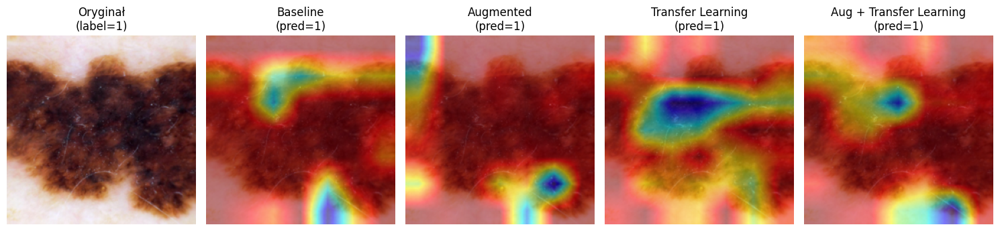

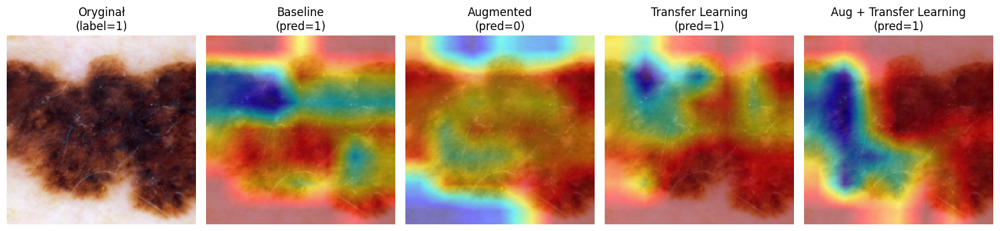

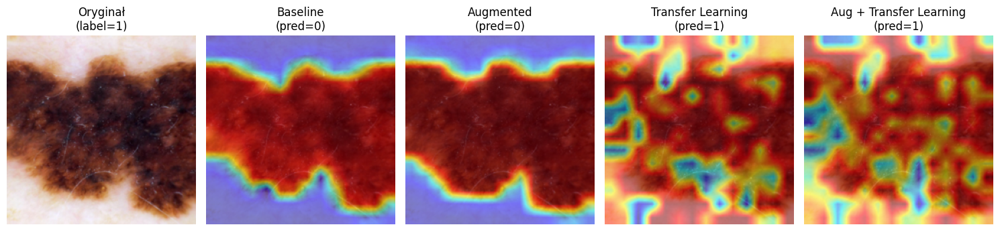

In [ ]:
isic_id = 'ISIC_0053456'
index = df_bcn20000[df_bcn20000['isic_id'] == isic_id].index[0]
image, label = bcn_dataset[index]

visualize_gradcam_variants(
    rn_models,
    image,
    label,
    target_layers=rn_target_layers,
    model_names=model_names,
    device=device
)
visualize_gradcam_variants(
    dn_models,
    image,
    label,
    target_layers=dn_target_layers,
    model_names=model_names,
    device=device
)
visualize_gradcam_variants(
    vit_models,
    image,
    label,
    target_layers=vit_target_layers,
    model_names=model_names,
    device=device
)

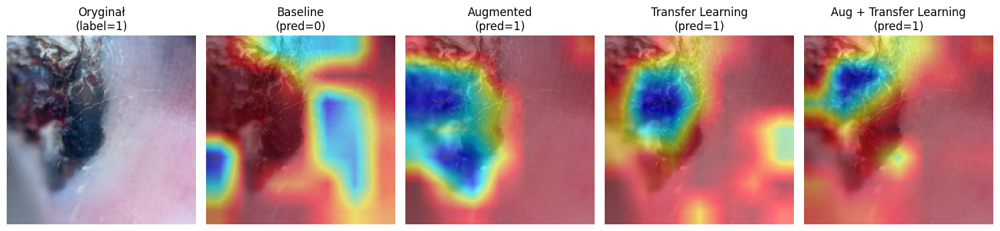

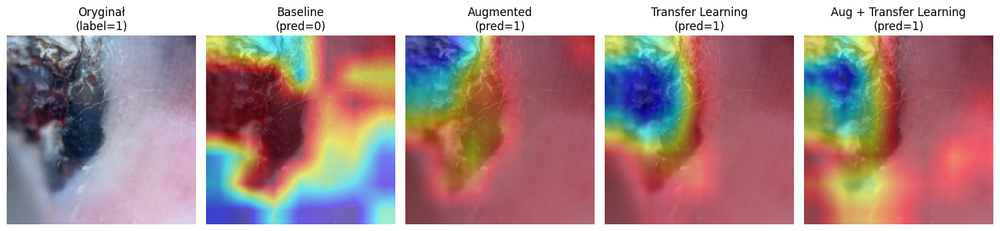

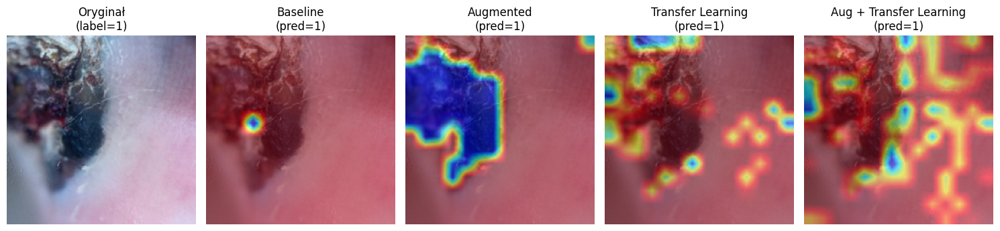

In [ ]:
isic_id = 'ISIC_0054194'
index = df_bcn20000[df_bcn20000['isic_id'] == isic_id].index[0]
image, label = bcn_dataset[index]

visualize_gradcam_variants(
    rn_models,
    image,
    label,
    target_layers=rn_target_layers,
    model_names=model_names,
    device=device
)
visualize_gradcam_variants(
    dn_models,
    image,
    label,
    target_layers=dn_target_layers,
    model_names=model_names,
    device=device
)
visualize_gradcam_variants(
    vit_models,
    image,
    label,
    target_layers=vit_target_layers,
    model_names=model_names,
    device=device
)

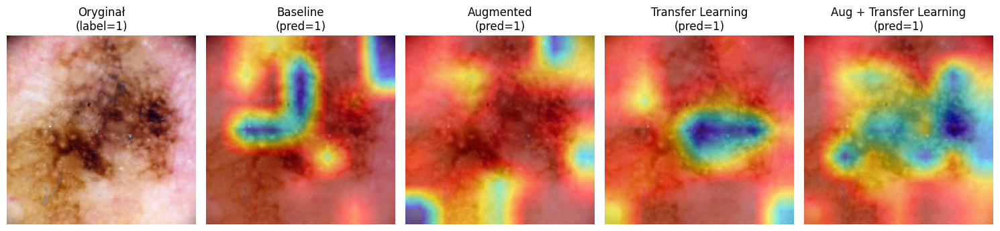

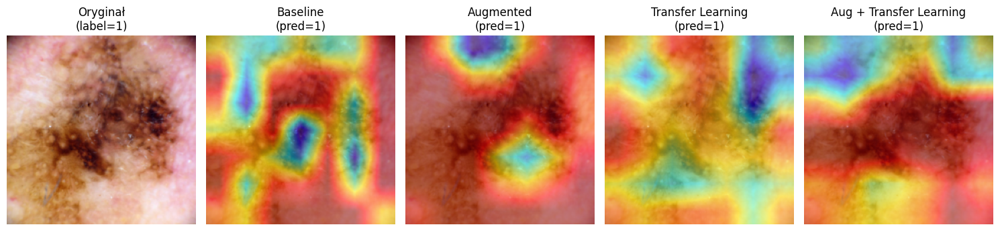

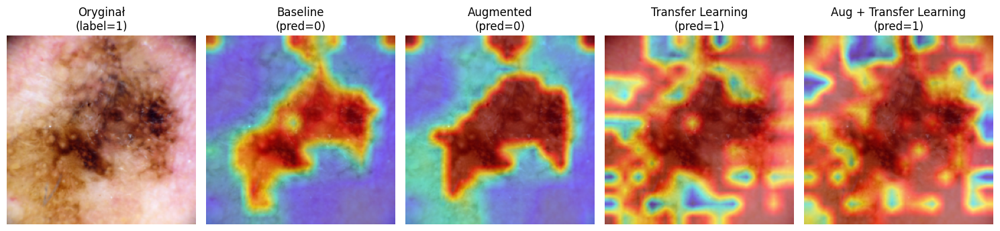

In [ ]:
isic_id = 'ISIC_0055091'
index = df_bcn20000[df_bcn20000['isic_id'] == isic_id].index[0]
image, label = bcn_dataset[index]

visualize_gradcam_variants(
    rn_models,
    image,
    label,
    target_layers=rn_target_layers,
    model_names=model_names,
    device=device
)
visualize_gradcam_variants(
    dn_models,
    image,
    label,
    target_layers=dn_target_layers,
    model_names=model_names,
    device=device
)
visualize_gradcam_variants(
    vit_models,
    image,
    label,
    target_layers=vit_target_layers,
    model_names=model_names,
    device=device
)

#### Artifacts

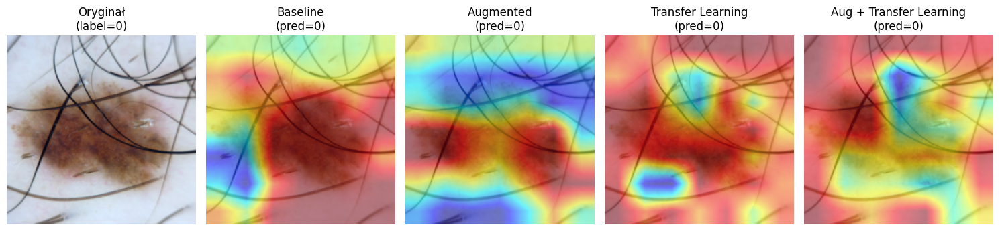

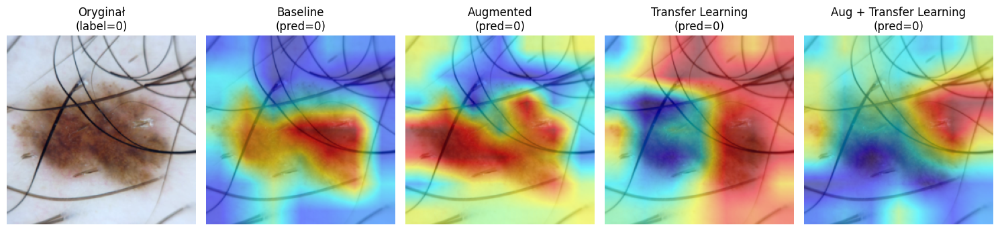

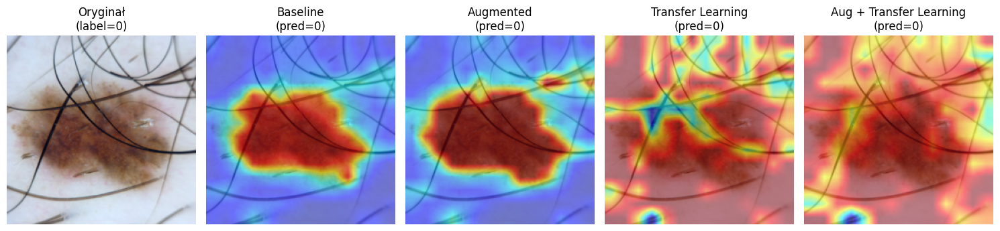

In [ ]:
isic_id = 'ISIC_0053711'
index = df_bcn20000[df_bcn20000['isic_id'] == isic_id].index[0]
image, label = bcn_dataset[index]

visualize_gradcam_variants(
    rn_models,
    image,
    label,
    target_layers=rn_target_layers,
    model_names=model_names,
    device=device
)
visualize_gradcam_variants(
    dn_models,
    image,
    label,
    target_layers=dn_target_layers,
    model_names=model_names,
    device=device
)
visualize_gradcam_variants(
    vit_models,
    image,
    label,
    target_layers=vit_target_layers,
    model_names=model_names,
    device=device
)

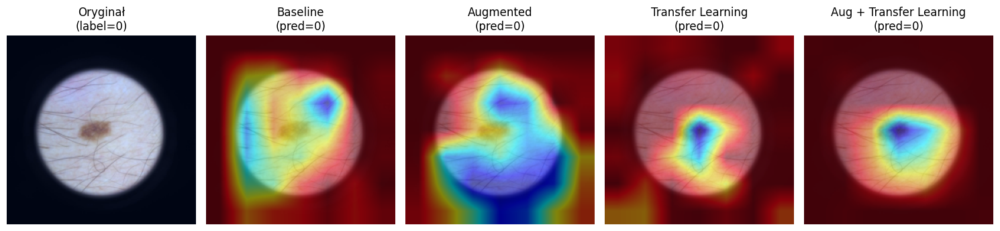

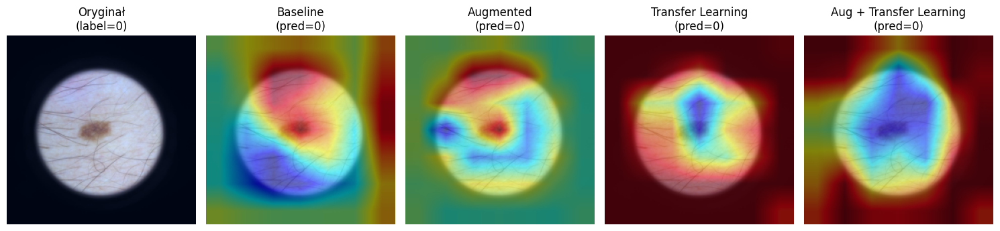

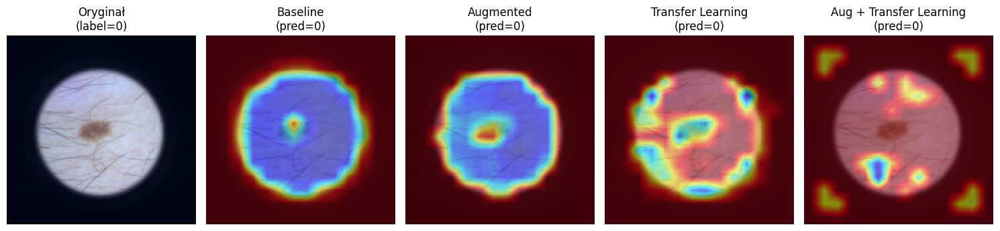

In [ ]:
isic_id = 'ISIC_0053643'
index = df_bcn20000[df_bcn20000['isic_id'] == isic_id].index[0]
image, label = bcn_dataset[index]

visualize_gradcam_variants(
    rn_models,
    image,
    label,
    target_layers=rn_target_layers,
    model_names=model_names,
    device=device
)
visualize_gradcam_variants(
    dn_models,
    image,
    label,
    target_layers=dn_target_layers,
    model_names=model_names,
    device=device
)
visualize_gradcam_variants(
    vit_models,
    image,
    label,
    target_layers=vit_target_layers,
    model_names=model_names,
    device=device
)

### HAM10000

#### Benign

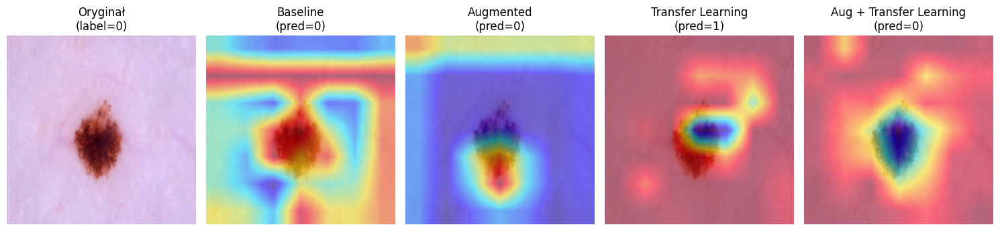

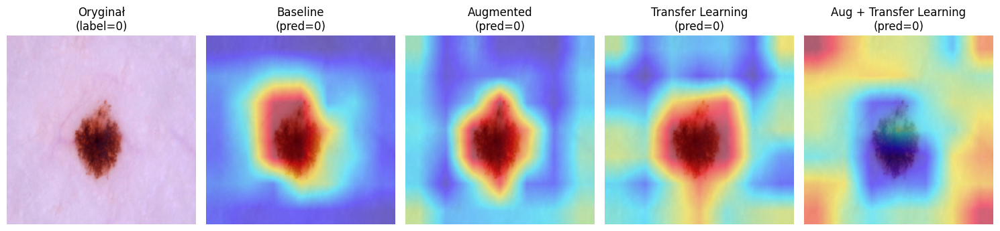

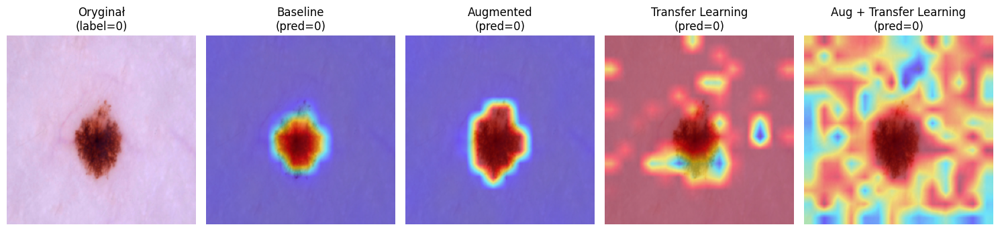

In [ ]:
image_id = 'ISIC_0024352'
index = df_ham10k[df_ham10k['image_id'] == image_id].index[0]
image, label, _ = dataset[index]

visualize_gradcam_variants(
    rn_models,
    image,
    label,
    target_layers=rn_target_layers,
    model_names=model_names,
    device=device
)

visualize_gradcam_variants(
    dn_models,
    image,
    label,
    target_layers=dn_target_layers,
    model_names=model_names,
    device=device
)

visualize_gradcam_variants(
    vit_models,
    image,
    label,
    target_layers=vit_target_layers,
    model_names=model_names,
    device=device
)

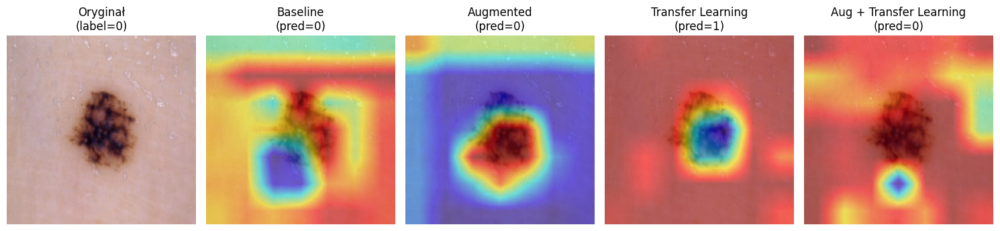

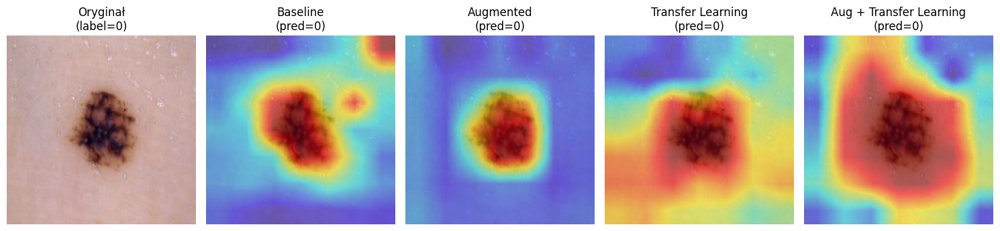

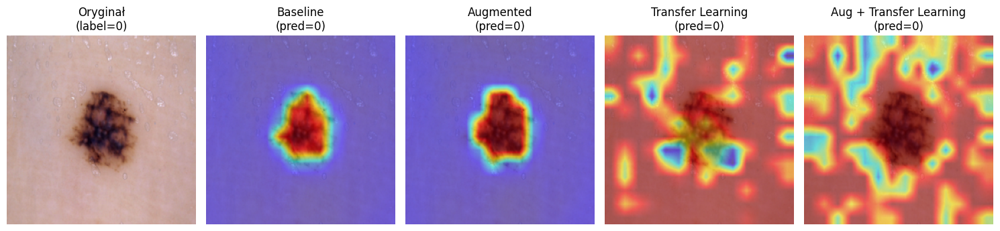

In [ ]:
image_id = 'ISIC_0024406'
index = df_ham10k[df_ham10k['image_id'] == image_id].index[0]
image, label, _ = dataset[index]

visualize_gradcam_variants(
    rn_models,
    image,
    label,
    target_layers=rn_target_layers,
    model_names=model_names,
    device=device
)

visualize_gradcam_variants(
    dn_models,
    image,
    label,
    target_layers=dn_target_layers,
    model_names=model_names,
    device=device
)

visualize_gradcam_variants(
    vit_models,
    image,
    label,
    target_layers=vit_target_layers,
    model_names=model_names,
    device=device
)

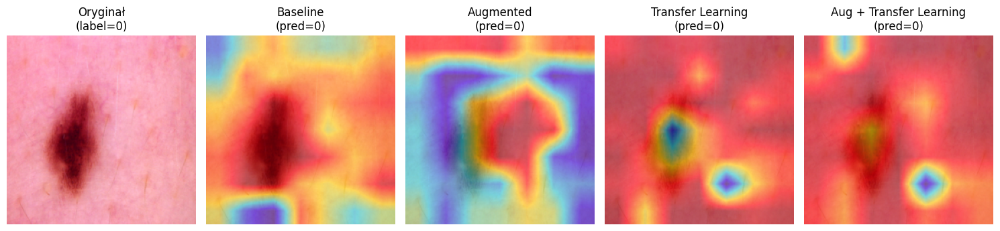

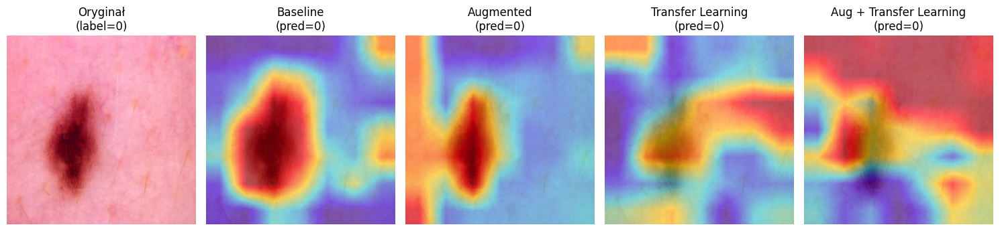

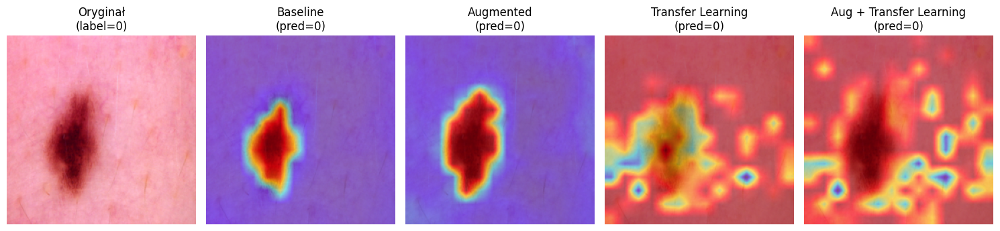

In [ ]:
image_id = 'ISIC_0024580'
index = df_ham10k[df_ham10k['image_id'] == image_id].index[0]
image, label, _ = dataset[index]

visualize_gradcam_variants(
    rn_models,
    image,
    label,
    target_layers=rn_target_layers,
    model_names=model_names,
    device=device
)

visualize_gradcam_variants(
    dn_models,
    image,
    label,
    target_layers=dn_target_layers,
    model_names=model_names,
    device=device
)

visualize_gradcam_variants(
    vit_models,
    image,
    label,
    target_layers=vit_target_layers,
    model_names=model_names,
    device=device
)

#### Malignant

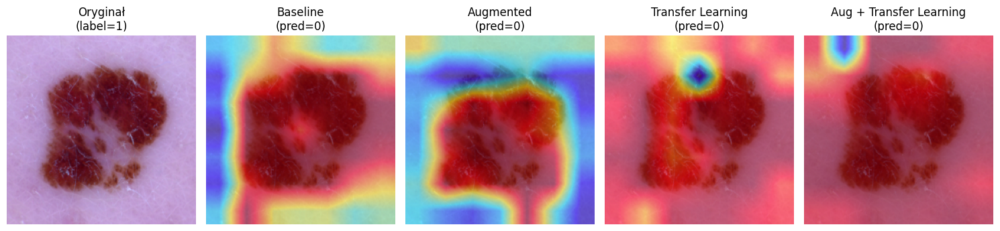

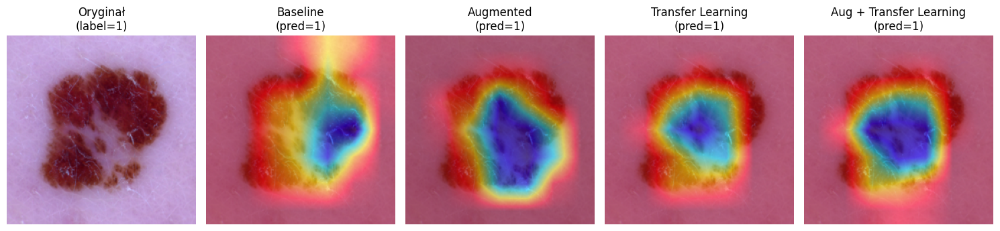

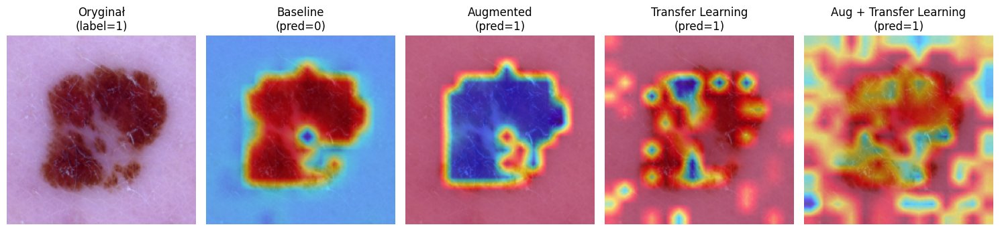

In [ ]:
image_id = 'ISIC_0026369'
index = df_ham10k[df_ham10k['image_id'] == image_id].index[0]
image, label, _ = dataset[index]

visualize_gradcam_variants(
    rn_models,
    image,
    label,
    target_layers=rn_target_layers,
    model_names=model_names,
    device=device
)

visualize_gradcam_variants(
    dn_models,
    image,
    label,
    target_layers=dn_target_layers,
    model_names=model_names,
    device=device
)

visualize_gradcam_variants(
    vit_models,
    image,
    label,
    target_layers=vit_target_layers,
    model_names=model_names,
    device=device
)

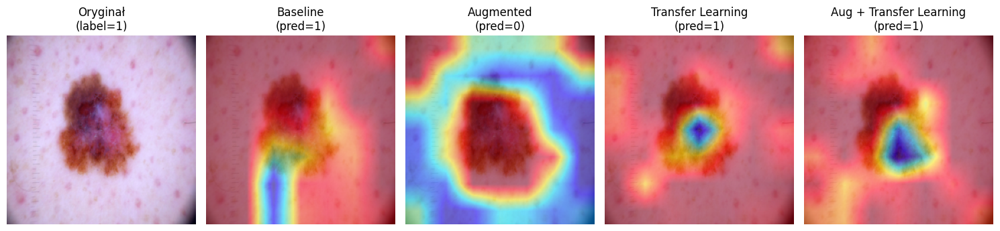

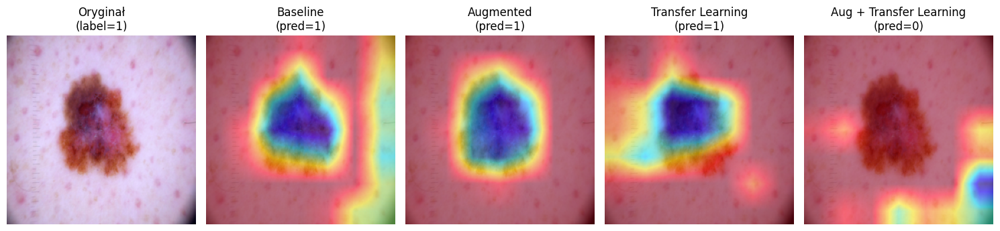

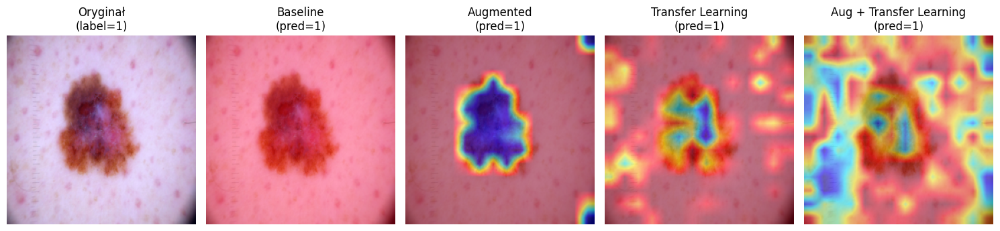

In [ ]:
image_id = 'ISIC_0028412'
index = df_ham10k[df_ham10k['image_id'] == image_id].index[0]
image, label, _ = dataset[index]

visualize_gradcam_variants(
    rn_models,
    image,
    label,
    target_layers=rn_target_layers,
    model_names=model_names,
    device=device
)

visualize_gradcam_variants(
    dn_models,
    image,
    label,
    target_layers=dn_target_layers,
    model_names=model_names,
    device=device
)

visualize_gradcam_variants(
    vit_models,
    image,
    label,
    target_layers=vit_target_layers,
    model_names=model_names,
    device=device
)

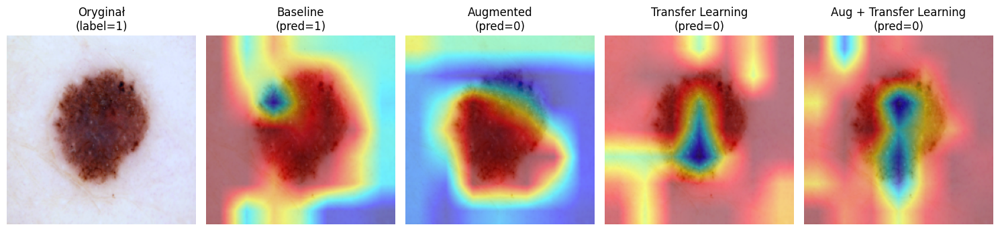

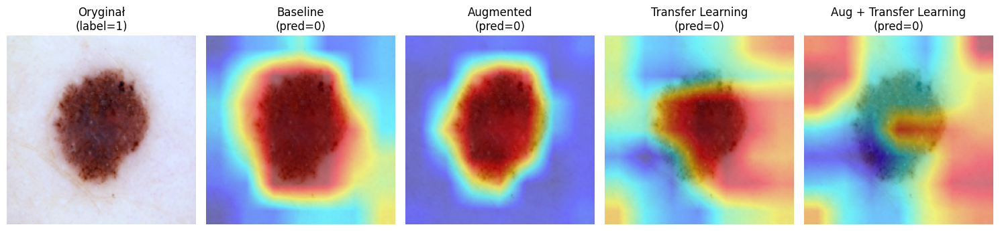

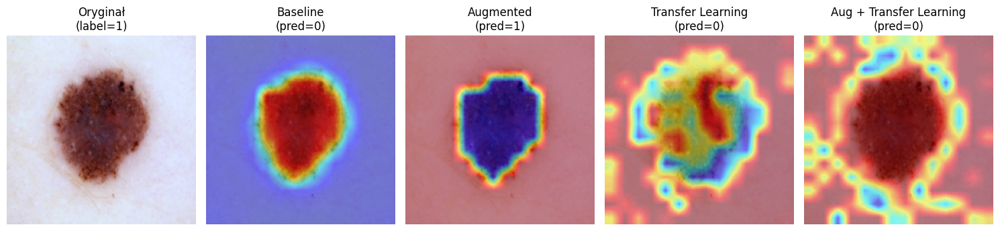

In [ ]:
image_id = 'ISIC_0026207'
index = df_ham10k[df_ham10k['image_id'] == image_id].index[0]
image, label, _ = dataset[index]

visualize_gradcam_variants(
    rn_models,
    image,
    label,
    target_layers=rn_target_layers,
    model_names=model_names,
    device=device
)

visualize_gradcam_variants(
    dn_models,
    image,
    label,
    target_layers=dn_target_layers,
    model_names=model_names,
    device=device
)

visualize_gradcam_variants(
    vit_models,
    image,
    label,
    target_layers=vit_target_layers,
    model_names=model_names,
    device=device
)

#### Artifacts

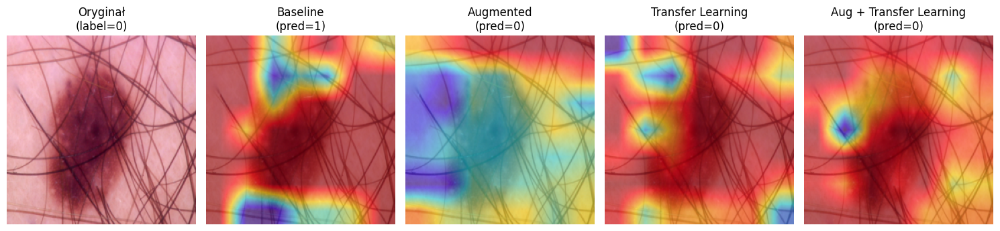

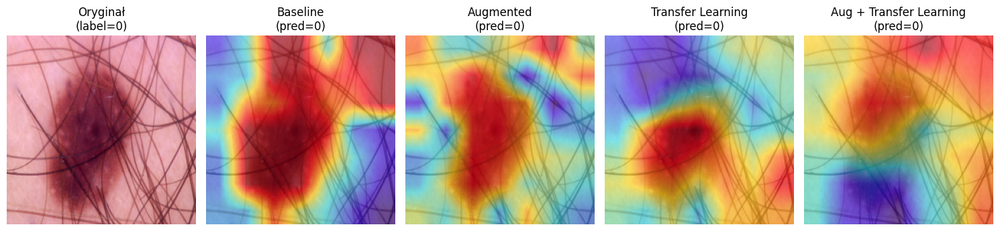

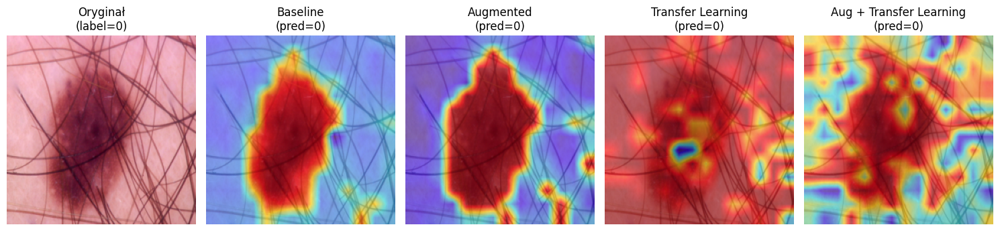

In [ ]:
image_id = 'ISIC_0024779'
index = df_ham10k[df_ham10k['image_id'] == image_id].index[0]
image, label, _ = dataset[index]

visualize_gradcam_variants(
    rn_models,
    image,
    label,
    target_layers=rn_target_layers,
    model_names=model_names,
    device=device
)

visualize_gradcam_variants(
    dn_models,
    image,
    label,
    target_layers=dn_target_layers,
    model_names=model_names,
    device=device
)

visualize_gradcam_variants(
    vit_models,
    image,
    label,
    target_layers=vit_target_layers,
    model_names=model_names,
    device=device
)

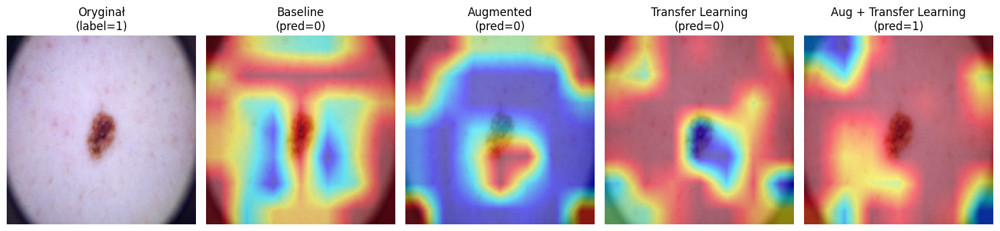

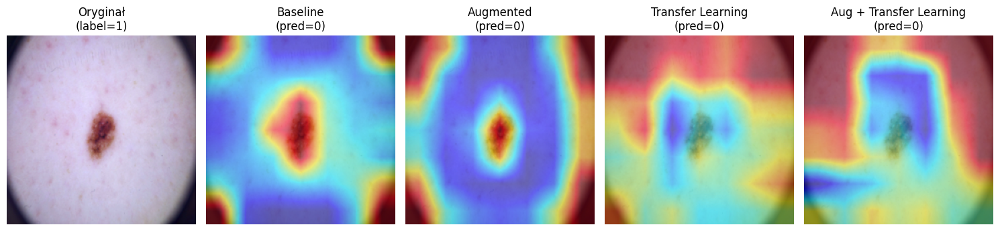

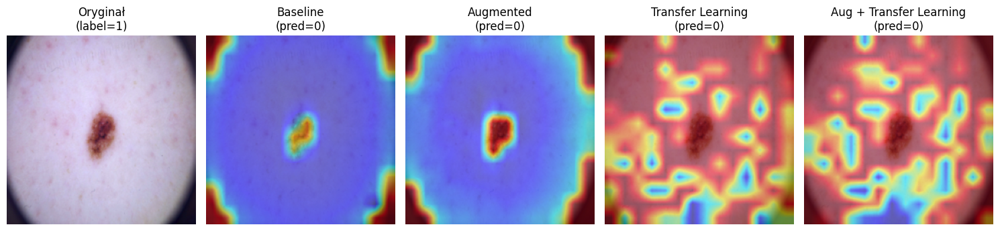

In [ ]:
image_id = 'ISIC_0025265'
index = df_ham10k[df_ham10k['image_id'] == image_id].index[0]
image, label, _ = dataset[index]

visualize_gradcam_variants(
    rn_models,
    image,
    label,
    target_layers=rn_target_layers,
    model_names=model_names,
    device=device
)

visualize_gradcam_variants(
    dn_models,
    image,
    label,
    target_layers=dn_target_layers,
    model_names=model_names,
    device=device
)

visualize_gradcam_variants(
    vit_models,
    image,
    label,
    target_layers=vit_target_layers,
    model_names=model_names,
    device=device
)